<a href="https://colab.research.google.com/github/mriared/Entropy-of-abstracts-and-the-citations-relationship/blob/main/Entropy_of_abstracts_pynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import nltk
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize, word_tokenize
import re
import matplotlib.pyplot as plt
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

##Loading the data

###Nature

In [ ]:
file_path_nature = '/content/nature 16to19.csv'
df = pd.read_csv(file_path_nature)

file_path_non_nature = '/content/scopus all 16to19 final.csv'
non_nature= pd.read_csv(file_path_non_nature)

In [ ]:
#Adding a column this an abstract without punctuation or special symbols
def clean_paragraph(paragraph):
    cleaned_paragraph = re.sub(r'[^a-zA-Z\s]', '', paragraph.lower())
    cleaned_paragraph = re.sub(r'\b@\b', '', cleaned_paragraph)
    cleaned_paragraph = re.sub(r'\b© 2020 Elsevier B\.V\.\b', '', cleaned_paragraph)
    return cleaned_paragraph

df['cleaned_abstract'] = df['abstract'].apply(clean_paragraph)
df['cleaned_sentences'] = df['abstract'].apply(lambda x: [clean_paragraph(sent) for sent in sent_tokenize(x)])

In [ ]:
df.shape

(2841, 5)

###Non nature

In [ ]:
non_nature

,title,Year,journal,citations,Link,abstract,abstract_len
0,"Cancer treatment and survivorship statistics, ...",2016,CA Cancer Journal for Clinicians,3949,https://www.scopus.com/inward/record.uri?eid=2...,The number of cancer survivors continues to in...,1557
1,Google Earth Engine: Planetary-scale geospatia...,2017,Remote Sensing of Environment,6603,https://www.scopus.com/inward/record.uri?eid=2...,Google Earth Engine is a cloud-based platform ...,328
2,Thematic Analysis: Striving to Meet the Trustw...,2017,International Journal of Qualitative Methods,5477,https://www.scopus.com/inward/record.uri?eid=2...,As qualitative research becomes increasingly r...,1209
3,MEGA7: Molecular Evolutionary Genetics Analysi...,2016,Molecular Biology and Evolution,33775,https://www.scopus.com/inward/record.uri?eid=2...,We present the latest version of the Molecular...,995
4,Fully Convolutional Networks for Semantic Segm...,2017,IEEE Transactions on Pattern Analysis and Mach...,6592,https://www.scopus.com/inward/record.uri?eid=2...,Convolutional networks are powerful visual mod...,975
...,...,...,...,...,...,...,...
3518,An Aluminum–Magnesium Variety of Caryopilite f...,2019,Geology of Ore Deposits,0,https://www.scopus.com/inward/record.uri?eid=2...,Abstract: A variety of caryopilite enriched in...,806
3519,Explant-like passaging of cells growing on por...,2019,Folia Biologica (Poland),0,https://www.scopus.com/inward/record.uri?eid=2...,The experiments presented in this paper show h...,1181
3520,Simulation of the Response of Microferrogel to...,2019,Journal of Applied Mechanics and Technical Phy...,0,https://www.scopus.com/inward/record.uri?eid=2...,A coarse-grained molecular dynamics method is ...,1279
3521,Decomposition Kinetics of Metastable β Phase i...,2019,Xiyou Jinshu Cailiao Yu Gongcheng/Rare Metal M...,0,https://www.scopus.com/inward/record.uri?eid=2...,Phase transformation kinetics of Ti-1300 alloy...,1410


In [ ]:
#sorting by the citations
non_nature = non_nature.sort_values(by='citations', ascending=False)
non_nature = non_nature.reset_index(drop=True)

In [ ]:
non_nature["cleaned_abstract"] = non_nature["abstract"].apply(clean_paragraph)
non_nature['cleaned_sentences'] = non_nature['abstract'].apply(lambda x: [clean_paragraph(sent) for sent in sent_tokenize(x)])

In [ ]:
non_nature.iloc[13]

title                ROBINS-I: A tool for assessing risk of bias in...
Year                                                              2016
journal                                                   BMJ (Online)
citations                                                         8508
Link                 https://www.scopus.com/inward/record.uri?eid=2...
abstract             Non-randomised studies of the effects of inter...
abstract_len                                                       225
cleaned_abstract     nonrandomised studies of the effects of interv...
cleaned_sentences    [nonrandomised studies of the effects of inter...
Name: 13, dtype: object

In [ ]:
non_nature = non_nature.drop(13).reset_index(drop=True)

In [ ]:
non_nature = non_nature.drop(25).reset_index(drop=True)

In [ ]:
pd.set_option('display.max_colwidth', None)
non_nature["citations"][:15]

0     59528
1     33775
2     23327
3     19255
4     16037
5     15661
6     13702
7     12177
8     11505
9     11104
10     9868
11     9539
12     9217
13     8088
14     8062
Name: citations, dtype: int64

In [ ]:
non_nature["title"][:15]

0                                                                                                                             Global cancer statistics 2018: GLOBOCAN estimates of incidence and mortality worldwide for 36 cancers in 185 countries
1                                                                                                                                                                    MEGA7: Molecular Evolutionary Genetics Analysis Version 7.0 for Bigger Datasets
2                                                                                                                                                                        MEGA X: Molecular evolutionary genetics analysis across computing platforms
3                                                                                                                                                                     Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks
4                   

In [ ]:
non_nature = non_nature.iloc[10:].reset_index(drop=True)

In [ ]:
non_nature = non_nature[non_nature['abstract_len'] < 3000]


In [ ]:
non_nature.shape

(3420, 9)

##Counting the statistics

In [ ]:
def basic_stats(df):
  # Sample DataFrame with a column of paragraphs
  df_stat = pd.DataFrame(df)

  # Tokenize paragraphs into words and sentences
  df_stat['WordTokens'] = df_stat['cleaned_abstract'].apply(lambda x: word_tokenize(x.lower()))  # Use lower() to make tokens case-insensitive
  df_stat['SentenceTokens'] = df_stat['abstract'].apply(lambda x: [clean_paragraph(sent) for sent in sent_tokenize(x)])

  # Count the number of tokens (words)
  df_stat['Number of Tokens'] = df_stat['WordTokens'].apply(len)

  # Count the number of types of tokens
  df_stat['Number of Types'] = df_stat['WordTokens'].apply(lambda x: len(set(x)))

  # Calculate the average length of a sentence
  df_stat['Avgerage Sentence Length'] = df_stat['SentenceTokens'].apply(lambda x: sum(len(sent.split()) for sent in x) / len(x) if len(x) > 0 else 0)

  #Create a DataFrame with the calculated statistics
  total_values = df_stat[['Number of Tokens', 'Number of Types', 'Avgerage Sentence Length']].sum().round(0)
  total_values['Avgerage Sentence Length'] = df_stat['Avgerage Sentence Length'].mean().round(0)
  total_values_df = pd.DataFrame({'Metric': total_values.index, 'Total': total_values.values})

  # Display the DataFrame with the calculated values
  return total_values_df

In [ ]:
total_values_df = basic_stats(df)
total_values_nonnature = basic_stats(non_nature)

In [ ]:
print(total_values_df)

                     Metric     Total
0          Number of Tokens  625074.0
1           Number of Types  373900.0
2  Avgerage Sentence Length      26.0


In [ ]:
print(total_values_nonnature)

                     Metric     Total
0          Number of Tokens  573540.0
1           Number of Types  333397.0
2  Avgerage Sentence Length      24.0


##Entropy caclulations

V  - number of typese <br>
N - number of tokens
<br>
<br>
Relative Frequancy: $\frac{V}{N}$

Self - information: $-\log_2(p_i)$

Word entropy: $ H = -\sum_{i=1}^{V} p_i \log_2(p_i) $

Relative Entropy: $ H_{\text{rel}} = \frac{H}{\log_2 V} $




###Words entropy

In [ ]:
from collections import Counter
import math

#calcuation entropy on all initial positions
def calculate_word_entropy(word_frequency):

    # Count total number of tokens n
    n = sum(word_frequency.values())

    # Calculation of total entropy
    entropy = -sum((frequency / n) * math.log2(frequency / n) for frequency in word_frequency.values())

    #calculation of relative entropy
    if math.log2(n)>0:
      relative_entropy = entropy / math.log2(n)
    else:
      relative_entropy = 0

    return entropy, relative_entropy


def calculate_additional_information(word_frequency):

    # Count the total number of tokens n
    n = sum(word_frequency.values())

    # Sort the word frequency dictionary by frequency in descending order
    sorted_word_frequency = dict(sorted(word_frequency.items(), key=lambda item: item[1], reverse=True))

    #Create a data frame which will store the measures of information
    df_information = []

    #Count relative frequancy, self-information and entropu
    for word, frequency in sorted_word_frequency.items():
        p1 = frequency / n
        self_information = -math.log2(p1)
        entropy = -p1 * math.log2(p1)

        df_information.append({
            'Word': word,
            'Frequency': frequency,
            'Relative Frequency (p1)': p1,
            'Self-Information (-log2p1)': self_information,
            'Entropy (-p1log2p1)': entropy
        })

    df_words = pd.DataFrame(df_information)

    #Add total entropy and realtive entropy to the data frame
    total_entropy, relative_total_entropy = calculate_word_entropy(sorted_word_frequency)
    df_words.loc[len(df_words)] = ['Total entropy', None, None, None, total_entropy]
    df_words.loc[len(df_words)] = ['Relative entropy', None, None, None, relative_total_entropy]


    return df_words

def process_paragraph(paragraph):

    words = paragraph.split()

    #Count the frequency of the words in an abstract
    word_frequency = Counter(words)

    #Calculate all measures of information for all words from an abastract and return it as a data frame
    df = calculate_additional_information(word_frequency)

    return df

#### Example usage:
#####Counting the word-form information measures for the abstract of the most cited paper

In [ ]:
df_words_entropy_most_cited = process_paragraph(df['cleaned_abstract'][0])
df_words_entropy_most_cited

,Word,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,and,11,0.052381,4.254814,0.222871
1,the,10,0.047619,4.392317,0.209158
2,treg,9,0.042857,4.544321,0.194757
3,cells,9,0.042857,4.544321,0.194757
4,brain,8,0.038095,4.714246,0.179590
...,...,...,...,...,...
124,against,1,0.004762,7.714246,0.036735
125,neuroinflammatory,1,0.004762,7.714246,0.036735
126,diseases,1,0.004762,7.714246,0.036735
127,Total entropy,None,NaN,NaN,6.510269


In [ ]:
non_nature_words_entropy_most_cited = process_paragraph(non_nature['cleaned_abstract'][0])
non_nature_words_entropy_most_cited

,Word,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,the,11,0.063218,3.983512,0.251831
1,and,8,0.045977,4.442943,0.204273
2,to,8,0.045977,4.442943,0.204273
3,of,7,0.040230,4.635589,0.186489
4,as,7,0.040230,4.635589,0.186489
...,...,...,...,...,...
108,clustering,1,0.005747,7.442943,0.042776
109,association,1,0.005747,7.442943,0.042776
110,itself,1,0.005747,7.442943,0.042776
111,Total entropy,None,NaN,NaN,6.387648


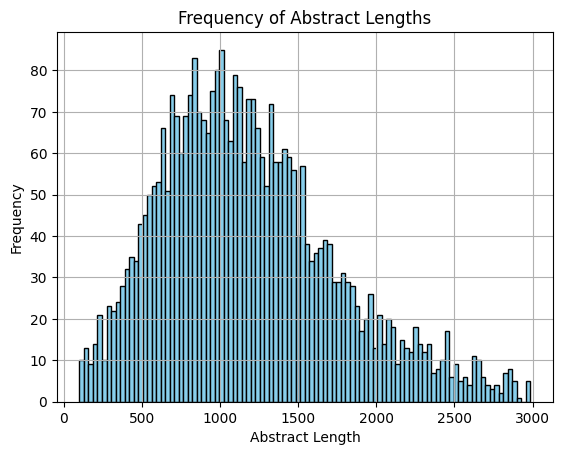

In [ ]:
non_nature_abs_length = non_nature.sort_values(by='abstract_len')
non_nature_abs_length = non_nature_abs_length[non_nature_abs_length['abstract_len'] < 3000]

# Plot the frequencies of the values in the "abstract_len" column
plt.hist(non_nature_abs_length['abstract_len'], bins=100, color='skyblue', edgecolor='black')
plt.xlabel('Abstract Length')
plt.ylabel('Frequency')
plt.title('Frequency of Abstract Lengths')
plt.grid(True)
plt.show()

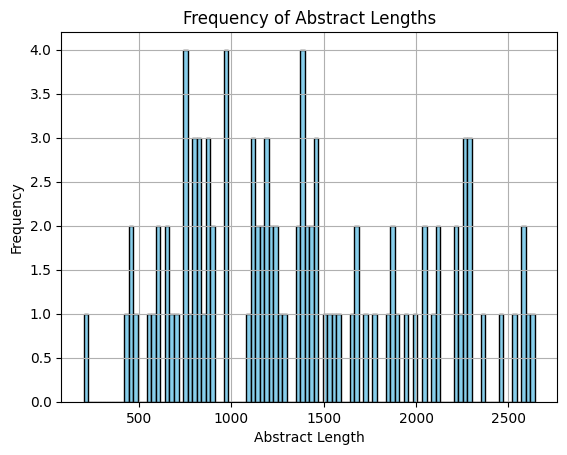

In [ ]:
# Plot the frequencies of the values in the "abstract_len" column
plt.hist(non_nature['abstract_len'][:100], bins=100, color='skyblue', edgecolor='black')
plt.xlabel('Abstract Length')
plt.ylabel('Frequency')
plt.title('Frequency of Abstract Lengths')
plt.grid(True)
plt.show()

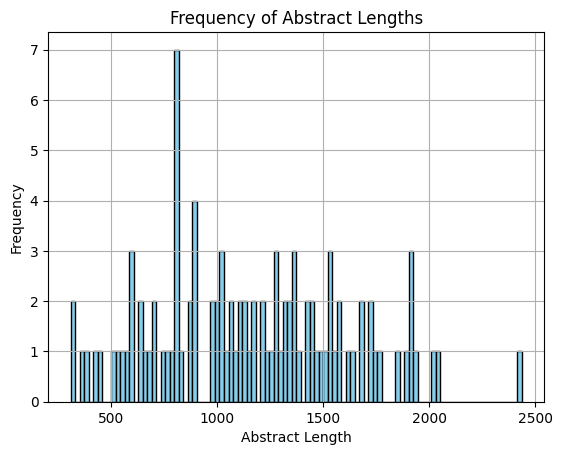

In [ ]:
# Plot the frequencies of the values in the "abstract_len" column
plt.hist(non_nature['abstract_len'][-100:], bins=100, color='skyblue', edgecolor='black')
plt.xlabel('Abstract Length')
plt.ylabel('Frequency')
plt.title('Frequency of Abstract Lengths')
plt.grid(True)
plt.show()

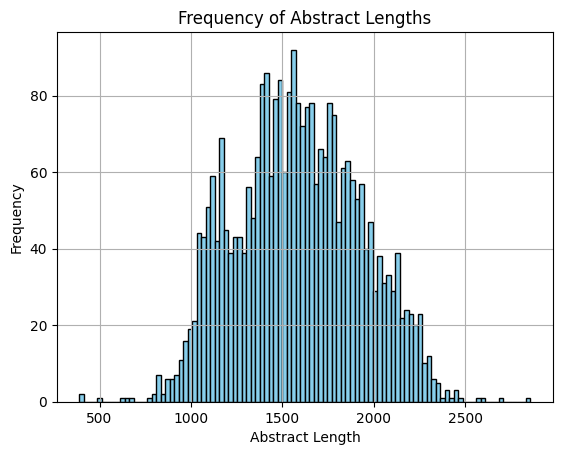

In [ ]:
df['abstract_len'] = df['abstract'].apply(len)
nature_abs_length = df.sort_values(by='abstract_len')

# Plot the frequencies of the values in the "abstract_len" column
plt.hist(nature_abs_length['abstract_len'], bins=100, color='skyblue', edgecolor='black')
plt.xlabel('Abstract Length')
plt.ylabel('Frequency')
plt.title('Frequency of Abstract Lengths')
plt.grid(True)
plt.show()

###Part of speech entropy

In [ ]:
def pos_frequency_analysis(paragraph):
    # Tokenize the abstracts into words
    words = word_tokenize(paragraph)

    # Perform part-of-speech tagging
    pos_tags = nltk.pos_tag(words)

    # Count the frequency of each part of speech
    pos_frequency = Counter(tag for word, tag in pos_tags)

    # Create a DataFrame to store the results
    df_information = []
    total_words = len(words)

    #Sort by frequency in descending order and count the relative frequency, self-information and pos entropy
    for rank, (pos, frequency) in enumerate(pos_frequency.most_common(), start=1):
        p1 = frequency / total_words
        self_information = -math.log2(p1)
        entropy = -p1 * math.log2(p1)

        df_information.append({
            'Part of Speech': pos,
            'Frequency Rank': rank,
            'Frequency': frequency,
            'Relative Frequency (p1)': p1,
            'Self-Information (-log2p1)': self_information,
            'Entropy (-p1log2p1)': entropy
        })

    # Calculate and add the entropies for all initial-position words
    total_entropy, relative_entropy = calculate_word_entropy(pos_frequency)

    df_pos = pd.DataFrame(df_information)
    df_pos.loc[len(df_pos)] = ['Total entropy', None, None, None, None, total_entropy]
    df_pos.loc[len(df_pos)] = ['Relative entropy', None, None, None, None, relative_entropy]

    return df_pos

#### Example usage:
#####Counting the POS-form information measures for the abstract of the most cited paper

In [ ]:
df_pos_entropy_most_cited = pos_frequency_analysis(df['cleaned_abstract'][0])
df_pos_entropy_most_cited

,Part of Speech,Frequency Rank,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,NN,1,61,0.290476,1.783508,0.518067
1,JJ,2,32,0.152381,2.714246,0.413599
2,IN,3,27,0.128571,2.959358,0.380489
3,NNS,4,21,0.100000,3.321928,0.332193
4,DT,5,14,0.066667,3.906891,0.260459
5,CC,6,11,0.052381,4.254814,0.222871
6,VBP,7,7,0.033333,4.906891,0.163563
7,RB,8,7,0.033333,4.906891,0.163563
8,VBZ,9,7,0.033333,4.906891,0.163563
9,VBG,10,5,0.023810,5.392317,0.128389


In [ ]:
non_nature_pos_entropy_most_cited = pos_frequency_analysis(non_nature['cleaned_abstract'][0])
non_nature_pos_entropy_most_cited

,Part of Speech,Frequency Rank,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,NN,1,37,0.212644,2.233490,0.474938
1,JJ,2,28,0.160920,2.635589,0.424118
2,IN,3,20,0.114943,3.121015,0.358737
3,NNS,4,18,0.103448,3.273018,0.338588
4,DT,5,16,0.091954,3.442943,0.316593
5,CC,6,10,0.057471,4.121015,0.236840
6,TO,7,8,0.045977,4.442943,0.204273
7,VB,8,8,0.045977,4.442943,0.204273
8,VBZ,9,7,0.040230,4.635589,0.186489
9,RB,10,6,0.034483,4.857981,0.167517


###Calculating the total entropy and the relative entropy for all abstracts

In [ ]:
#Calculate the word-fom entropies
def word_entropy_for_all_abstracts(df_all, column):
  # Create a new DataFrame to store the results
  total_word_entropy = pd.DataFrame(columns=['Abstract', 'Total Entropy', 'Relative Entropy'])
  # Iterate through each row in the original DataFrame
  for index, row in df_all.iterrows():
      paragraph = row[column]
      word_entropy_table = process_paragraph(paragraph)  # Extract the total entropy value
      word_entropy_value = word_entropy_table['Entropy (-p1log2p1)'].iloc[-2]
      relative_entropy_word_value = word_entropy_table['Entropy (-p1log2p1)'].iloc[-1]  # Extract the total entropy value
      total_word_entropy = total_word_entropy.append({'Abstract': paragraph, 'Total Entropy':word_entropy_value, 'Relative Entropy': relative_entropy_word_value}, ignore_index=True)
  return total_word_entropy

#Calculate the POS-fom entropies
def pos_entropy_for_all_abstracts(df_all, column):
  # Create a new DataFrame to store the results
  total_pos_entropy = pd.DataFrame(columns=['Abstract', 'Pos Total Entropy', 'Pos Relative Entropy'])

  # Iterate through each row in the original DataFrame
  for index, row in df_all.iterrows():
      paragraph = row[column]
      pos_entropy_table = pos_frequency_analysis(paragraph)
      pos_entropy_value = pos_entropy_table['Entropy (-p1log2p1)'].iloc[-2]
      relative_entropy_pos_value = pos_entropy_table['Entropy (-p1log2p1)'].iloc[-1]  # Extract the total entropy value
      total_pos_entropy = total_pos_entropy.append({'Abstract': paragraph, 'Pos Total Entropy':pos_entropy_value, 'Pos Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
  return total_pos_entropy

In [ ]:
# Create a new DataFrame to store the entropies of all abstracts
total_relative_word_entropy = word_entropy_for_all_abstracts(df, "cleaned_abstract")
total_relative_pos_entropy = pos_entropy_for_all_abstracts(df, "cleaned_abstract")

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': paragraph, 'Pos Total Entropy':pos_entropy_value, 'Pos Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': paragraph, 'Pos Total Entropy':pos_entropy_value, 'Pos Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': para

In [ ]:
total_relative_pos_entropy.tail(20)

,Abstract,Pos Total Entropy,Pos Relative Entropy
2821,blinking or fluorescence intermittency refers to a random switching between on bright and off dark states of an emitter it has been studied widely in zerodimensional quantum dots and molecules and scarcely in onedimensional systems a generally accepted mechanism for blinking in quantum dots involves random switching between neutral and charged states or is accompanied by fluctuations in chargecarrier traps which substantially alters the dynamics of radiative and nonradiative decay here we uncover a new type of blinking effect in vertically stacked twodimensional semiconductor heterostructures which consist of two distinct monolayers of transition metal dichalcogenides tmds that are weakly coupled by van der waals forces unlike zerodimensional or onedimensional systems twodimensional tmd heterostructures show a correlated blinking effect comprising randomly switching bright neutral and dark states fluorescence crosscorrelation spectroscopy analyses show that a bright state occurring in one monolayer will simultaneously lead to a dark state in the other monolayer owing to an intermittent interlayer carriertransfer process our findings suggest that bilayer van der waals heterostructures provide unique platforms for the study of chargetransfer dynamics and nonequilibriumstate physics and could see application as correlated light emitters in quantum technology,3.521453,0.465663
2822,the type iii secretion ts injectisome is a specialized protein nanomachine that is critical for the pathogenicity of many gramnegative bacteria including purveyors of plague typhoid fever whooping cough sexually transmitted infections and major nosocomial infections this syringeshaped mda macromolecular assembly spans both bacterial membranes and that of the infected host cell the internal channel formed by the injectisome allows for the direct delivery of partially unfolded virulence effectors into the host cytoplasm the structural foundation of the injectisome is the basal body a molecular locknut structure composed predominantly of three proteins that form highly oligomerized concentric rings spanning the inner and outer membranes here we present the structure of the prototypical salmonella enterica serovar typhimurium pathogenicity island basal body determined using singleparticle cryoelectron microscopy with the innermembranering and outermembranering oligomers defined at and resolution respectively this work presents the first to our knowledge highresolution structural characterization of the major components of the basal body in the assembled state including that of the widespread class of outermembrane portals known as secretins,3.285635,0.442936
2823,young stars are associated with prominent outflows of molecular gas the ejection of gas is believed to remove angular momentum from the protostellar system permitting young stars to grow by the accretion of material from the protostellar disk the underlying mechanism for outflow ejection is not yet understood but is believed to be closely linked to the protostellar disk various models have been proposed to explain the outflows differing mainly in the region where acceleration of material takes place close to the protostar itself xwind or stellar wind in a larger region throughout the protostellar disk disk wind or at the interface between the two outflow launching regions have so far been probed only by indirect extrapolation because of observational limits here we report resolved images of carbon monoxide towards the outflow associated with the tmca protostellar system these data show that gas is ejected from a region extending up to a radial distance of astronomical units from the central protostar and that angular momentum is removed from an extended region of the disk this demonstrates that the outflowing gas is launched by an extended disk wind from a keplerian disk,3.507857,0.462935
2824,enzymes are ideal for use in asymmetric catalysis by

In [ ]:
# Create a new DataFrame to store the entropies of all abstracts
non_nature_total_relative_word_entropy = word_entropy_for_all_abstracts(non_nature, "cleaned_abstract")
non_nature_total_relative_pos_entropy = pos_entropy_for_all_abstracts(non_nature, "cleaned_abstract")
non_nature_total_relative_pos_entropy.tail(20)

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': paragraph, 'Pos Total Entropy':pos_entropy_value, 'Pos Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': paragraph, 'Pos Total Entropy':pos_entropy_value, 'Pos Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-30-11ad9924543e>:25: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_pos_entropy = total_pos_entropy.append({'Abstract': para

,Abstract,Pos Total Entropy,Pos Relative Entropy
3400,swelling of neck always have a wide range of differential diagnosis salivary glands are group of organs that secretes saliva which helps in normal functioning of the oral cavity many conditions affect the salivary gland because of its size and location sialadenitis is the inflammatory condition of the salivary gland which is commonly encountered yet infrequently discussed topic sialoliths are calcified organic matter that forms with in the secretory system of the major and minor salivary glands sialolithiasis is one of the major causes for sialadenitis which has been shown in many studies here we have discussed about a swelling which was present in the right submandibular region with a duration of weeks for which opg lateral ceph and ultrasound has been taken for finalising the diagnosis,3.464579,0.495741
3401,objectives the objectives of the study were as follows to find effect of roods approach in sensory abnormalities to find effectof roods approach in muscle weakness method ethical clearance was obtained from the institutional ethical committee a total of diabetic neuropathy subjects were assessed and were included in this study based on inclusion criteria the individuals were allocated in one group this group received roods approach depending upon patients condition either facilitatory or inhibitory techniques were given diabetic neuropathy was diagnosed using michigan neuropathy screening instrument questionnaire and preand post test were done for assessing severity of diabetic neuropathy using visual analogue scale vas quantitative sensory testing qst and walking impairment questionnaire wiq and the outcome measures were analysed after months results within the group statistical analysis prepost vas score was and was extremely significant prepost qst score was and result was extremely significant and prepost wiq score was was also significant conclusion we found that facilitatory techniques of roods approach heavy joint compression and quick stretch were effective in improving decreased sensations and improving motor performance in patients with painful diabetic polyneuropathywe found that inhibitory techniques of roods approach maintained stretch and light joint compression were effective in decreasing hypersensitivity in patients with painful diabetic polyneuropathywe found significant improvement in pain measure vas sensory measure quantitative sensory testing and motor performance measure walking impairment questionnaire,3.143018,0.401911
3402,alopecia areata aa is a common autoimmune disorder that targets anagen hair follicles the most widely accepted hypothesis in its pathogenesis is that it is a tcellmediated autoimmune condition in genetically predisposed individuals micrornas mirnas are implicated in disease etiology and treatment interestingly mirnas and c have shown an important role in alopecia areata since mirna can be used as serum biomarker in other autoimmune diseases this study aimed to assess and compare serum levels of mirnas and c in aa patients with their levels in healthy subjects correlate their levels to severity of aa serum levels of mirnas and c were estimated by qrtpcr technique and mirnas and c were found to be significantly higher in aa patients compared to controls microrna however showed no significant difference between serum levels of aa patients compared to controls these findings suggest the important role of mirnas c and in the pathogenesis of aa,3.612149,0.498370
3403,bacterial meningitis is prevalent in pediatric populations worldwide and associated with mortality and neurological complications in tropical and subtropical regions this study aimed to evaluate inuse clinical diagnostic approaches against two pcr method in detection of bacterial pathogens implicated in pediatric meningitis in taif city saudi arabia the tested pcr method were realtime and multiplex polymerase chainreaction rtpcr and mpcrone hundred and fifteen csf sa

###Plotting the words-form entropy

In [ ]:
def all_word_entropy_plot(df, name, color):
  # Given values
  values_all_word_entropy = df["Relative Entropy"]
  plt.figure(figsize=(20, 6))

  # Plotting
  plt.plot(values_all_word_entropy,  linestyle='-', color=color)
  plt.title(f'Word form entropy for all abstracts from {name}')
  plt.xlabel(f'Most cited abstracts from {name}')
  plt.ylabel('Word entropy')
  plt.ylim(0)
  plt.grid(True)

  return plt.show()

In [ ]:
x = 0.7
y = 1.05

In [ ]:
nature_name = "Nature 2016-2019"

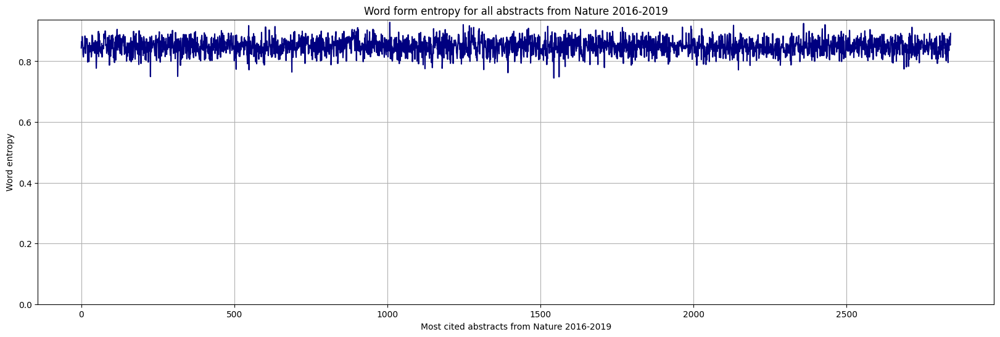

In [ ]:
all_word_entropy_plot(total_relative_word_entropy, nature_name, 'navy')

In [ ]:
non_nature_name = "Scopus 2016-2019"

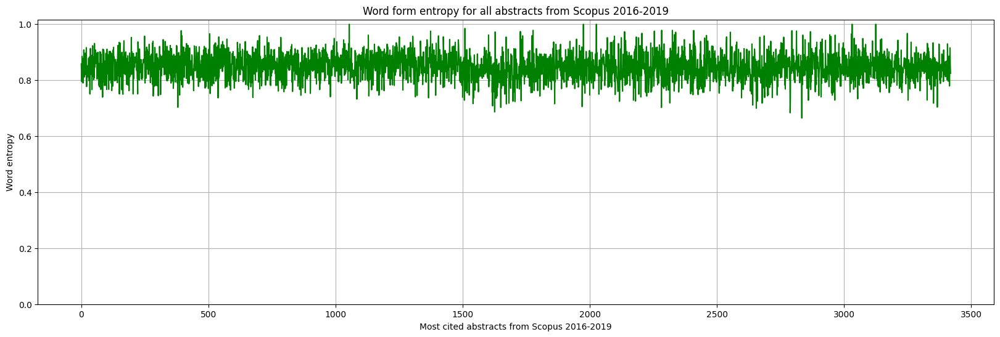

In [ ]:
all_word_entropy_plot(non_nature_total_relative_word_entropy, non_nature_name, 'green')

In [ ]:
def most_least_word_entropy_plt(df, name, n_cited_words, color_1, color_2):
  values_all_word_entropy = df["Relative Entropy"]

  #Plot for n most and n least cited articles
  #n_cited_words = 100
  x_values = list(range(1, n_cited_words+1))

  # Select the first n_cited and last n_cited values
  first_values = values_all_word_entropy[:n_cited_words]
  last_values = values_all_word_entropy[-n_cited_words:]

  plt.figure(figsize=(15, 6))

  # Plotting
  plt.plot(x_values, first_values, marker='o', linestyle='-', color= color_1, label=f'{n_cited_words} most cited abstracts')
  plt.plot(x_values, last_values, marker='o', linestyle='-', color= color_2, label=f'{n_cited_words} least cited abstracts')
  plt.title(f'{name}')
  plt.xlabel(f'Abstracts')
  plt.ylabel('Relative Word Entropy')
  plt.ylim(x, y)
  plt.legend()
  plt.grid(True)

  return plt.show()

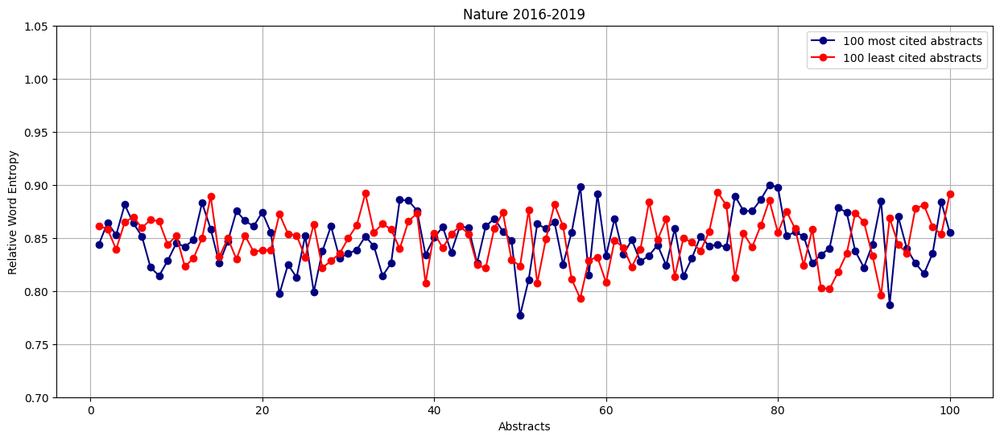

In [ ]:
most_least_word_entropy_plt(total_relative_word_entropy, nature_name, 100, "navy", "red" )

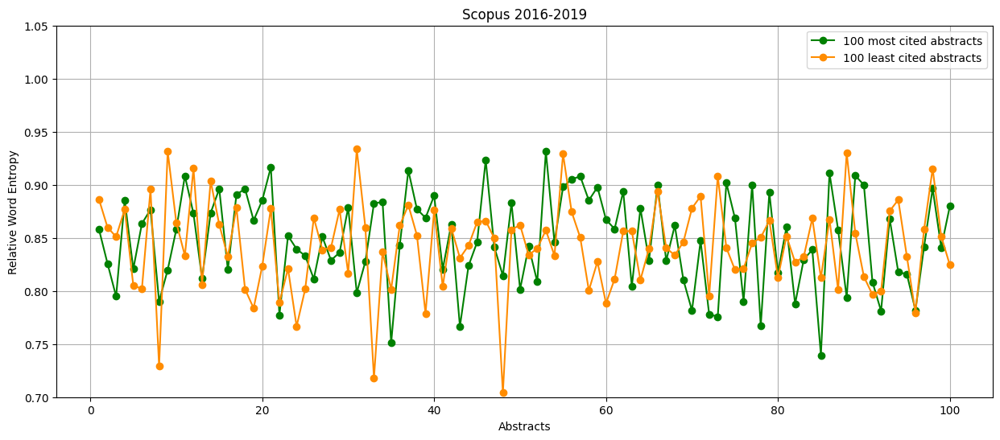

In [ ]:
most_least_word_entropy_plt(non_nature_total_relative_word_entropy, non_nature_name, 100, "green", "darkorange" )

In [ ]:
def word_entropy_plt(df1, df2, name1, name2, n_cited_words, color_1, color_2):
  #Plot for n most and n least cited articles
  x_values = list(range(1, n_cited_words+1))

  # Select the first n_cited and last n_cited values
  first_values = df1["Relative Entropy"][:n_cited_words]
  second_values = df2["Relative Entropy"][:n_cited_words]

  plt.figure(figsize=(15, 6))

  # Plotting
  plt.plot(x_values, first_values, marker='o', linestyle='-', color= color_1, label=f'{n_cited_words} most cited abstracts from {name1}')
  plt.plot(x_values, second_values, marker='o', linestyle='-', color= color_2, label=f'{n_cited_words} most cited abstracts from {name2}')
  plt.title(f'Relative Word-Form Entropy')
  plt.xlabel(f'Astracts')
  plt.ylabel('Relative Word Entropy')
  plt.ylim(x, y)
  plt.legend()
  plt.grid(True)

  return plt.show()

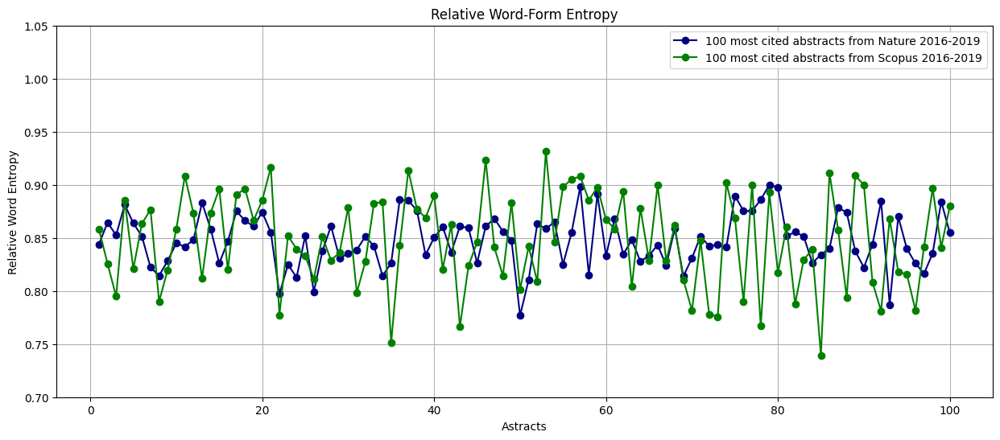

In [ ]:
word_entropy_plt(total_relative_word_entropy, non_nature_total_relative_word_entropy, nature_name, non_nature_name, 100, "navy", "green" )

####Plotting POS entropy

In [ ]:
#Plot for all values
def all_pos_entropy_plt(df, name, color):
  values_all_pos_entropy = df["Pos Relative Entropy"]
  plt.figure(figsize=(20, 6))

  # Plotting
  plt.plot(values_all_pos_entropy,  linestyle='-', color=color)
  plt.title(f'Parts of speech form entropy for all abstracts {name}')
  plt.xlabel(f'Most cited abstracts from {name}')
  plt.ylabel('Relative POS entropy')
  plt.ylim(0,1)
  plt.grid(True)
  return plt.show()

In [ ]:
px = 0.3
py = 0.6

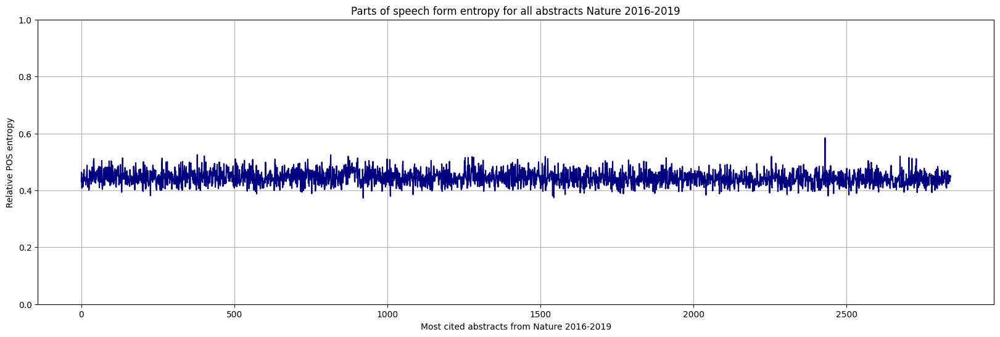

In [ ]:
all_pos_entropy_plt(total_relative_pos_entropy, nature_name, "navy")

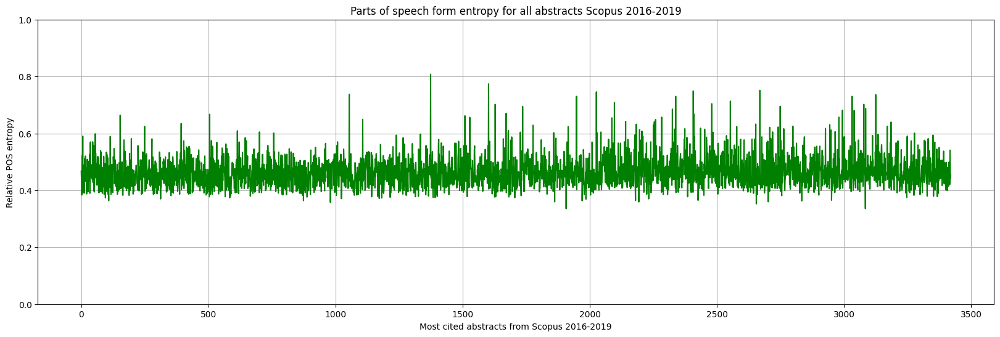

In [ ]:
all_pos_entropy_plt(non_nature_total_relative_pos_entropy, non_nature_name, "green")

In [ ]:
#Plot for n most cited and n least cited articles
def most_least_pos_entropy_plt(df, name, n_cited_words, color_1, color_2):
  n_cited_pos = 100

  entropy_values_pos = df["Pos Relative Entropy"]

  x_values = list(range(1, n_cited_words+1))

  # Select the first n_cited and last n_cited values
  first_values_pos = entropy_values_pos[:n_cited_pos]
  last_values_pos = entropy_values_pos[-n_cited_pos:]

  plt.figure(figsize=(15, 6))

  # Plotting
  plt.plot(x_values, first_values_pos, marker='o', linestyle='-', color=color_1, label=f'{n_cited_pos} most cited abstracts')
  plt.plot(x_values, last_values_pos, marker='o', linestyle='-', color=color_2, label=f'{n_cited_pos} least cited abstracts')
  plt.title(f'{name}')
  plt.xlabel(f'Abstracts')
  plt.ylabel('Relative POS Entropy')
  plt.ylim(px, py)
  plt.legend()
  plt.grid(True)
  plt.show()

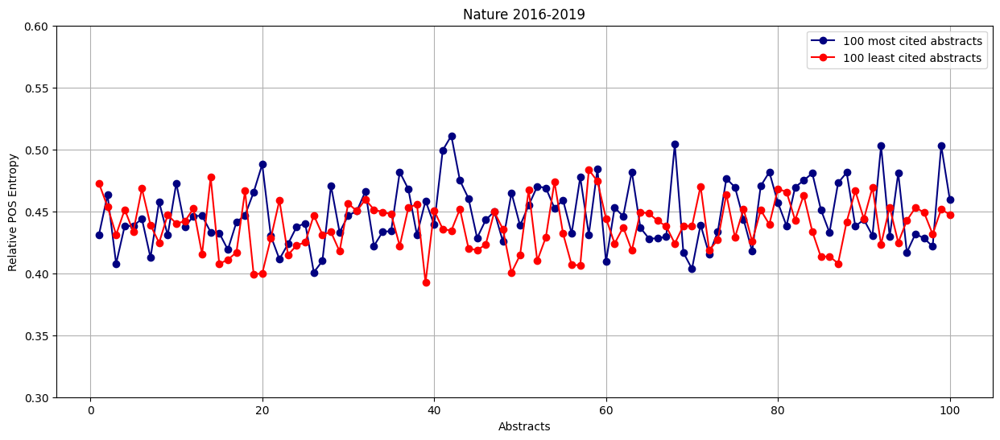

In [ ]:
most_least_pos_entropy_plt(total_relative_pos_entropy, nature_name, 100, "navy", "red")

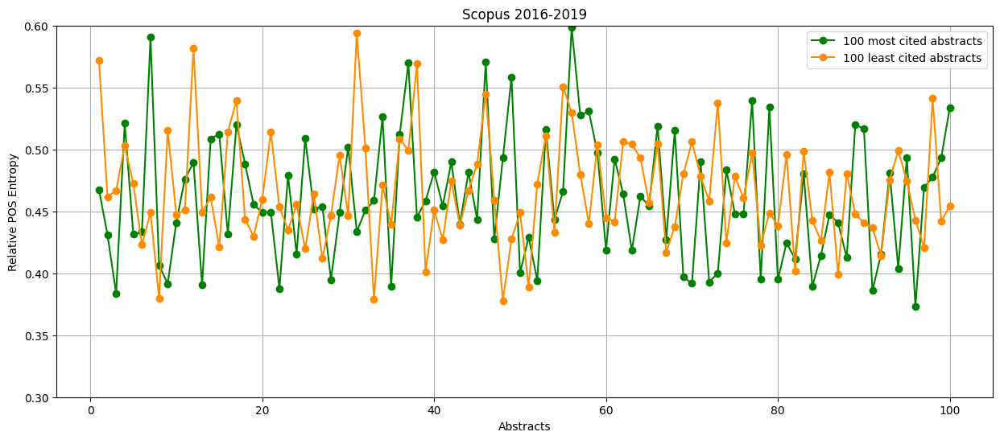

In [ ]:
most_least_pos_entropy_plt(non_nature_total_relative_pos_entropy, non_nature_name, 100, "green", "darkorange" )

In [ ]:
#Plot for n most cited and n least cited articles
def pos_entropy_plt(df1, df2, name1, name2, n_cited_words, color_1, color_2):
  n_cited_pos = 100

  x_values = list(range(1, n_cited_words+1))

  # Select the first n_cited and last n_cited values
  first_values_pos = df1["Pos Relative Entropy"][:n_cited_pos]
  second_values_pos = df2["Pos Relative Entropy"][:n_cited_pos]

  plt.figure(figsize=(15, 6))

  # Plotting
  plt.plot(x_values, first_values_pos, marker='o', linestyle='-', color=color_1, label=f'{n_cited_pos} most cited abstracts from {name1}')
  plt.plot(x_values, second_values_pos, marker='o', linestyle='-', color=color_2, label=f'{n_cited_pos} most cited abstracts from {name2}')
  plt.title(f'Relative Parts Of Speech Entropy of {n_cited_words} most and {n_cited_words} least cited abstracts')
  plt.xlabel(f'Abstracts')
  plt.ylabel('Relative POS Entropy')
  plt.ylim(px, py)
  plt.legend()
  plt.grid(True)
  return plt.show()

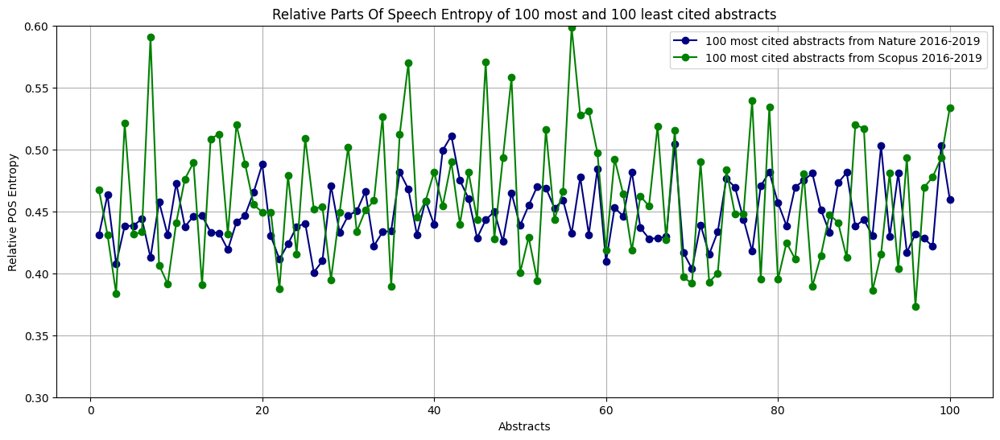

In [ ]:
pos_entropy_plt(total_relative_pos_entropy, non_nature_total_relative_pos_entropy, nature_name, non_nature_name, 100,"navy", "green" )

#Entropy for intitial sentential positions

####Calculating the longest sentence


In [ ]:
def longest_sentence(df, column):
  df_longest = pd.DataFrame()

  df_longest["cleaned"] = df[column].apply(lambda x: [clean_paragraph(sent) for sent in sent_tokenize(x)])
  # Find the longest sentence in each list of cleaned sentences
  df_longest['Longest Sentence'] = df_longest["cleaned"].apply(lambda x: max(x, key=len) if x else "")

  # Find the length of the longest sentence
  df_longest['Length of Longest Sentence'] = df_longest['Longest Sentence'].apply(lambda x: len(x.split()) if x else 0)

  max_length  = max(df_longest['Length of Longest Sentence'])
  return max_length

#### Seperating the sentences of each abstract into a Data Frame with sentential positions

In [ ]:
def word_columns_transform(df, column):
    # Sample DataFrame with 'abstrakt' column
    df_new = pd.DataFrame(df[column])

    # Count the length of the longest sentence
    max_sentences= longest_sentence(df,column)

    # Tokenize paragraphs into sentences and clean each sentence
    df_new['sentences'] = df_new[column].apply(lambda x: [clean_paragraph(sent) for sent in sent_tokenize(x)])

    # Create a new DataFrame for sentential positions and words
    result_df_position = pd.DataFrame()

    # Populate 'sentential position' column
    result_df_position["Abstract"] = list(range(1, len(df[column])+1))

    # Populate 'word' columns with concatenated words for each sentential position
    for i in range(1, max_sentences + 1):
        result_df_position[f'word_{i}'] = df_new['sentences'].apply(
            lambda x: ' '.join(word_tokenize(sentence)[i-1] if len(word_tokenize(sentence)) >= i else '' for sentence in x)
        )

    # Display the result DataFrame
    return result_df_position

#####A data frame contating all the words from all the abstracts separated into sentatentail positions

In [ ]:
result_df_position = word_columns_transform(df, "abstract")

<ipython-input-55-55d0fa56105d>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df_position[f'word_{i}'] = df_new['sentences'].apply(
<ipython-input-55-55d0fa56105d>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df_position[f'word_{i}'] = df_new['sentences'].apply(


In [ ]:
result_df_position

,Abstract,word_1,word_2,word_3,word_4,word_5,word_6,word_7,word_8,word_9,...,word_92,word_93,word_94,word_95,word_96,word_97,word_98,word_99,word_100,word_101
0,1,in however here although the brain stroke our,addition the we brain amplification treg is findings,to characteristics show treg of cells a suggest,maintaining and that cells brain suppress leading that,immune functions there are treg neurotoxic cause treg,tolerance of is similar cells astrogliosis of cells,foxp brain massive to is by neurological and,regulatory treg accumulation treg dependent producing disability their,t cells of cells on amphiregulin and products,...,,,,,,,,,,
1,2,mammalian although characterization here we notably together,gene transcription of we show we our,expression is transcriptional determine that provide data,is known bursting transcriptomewide core transcriptomewide show,inherently to including burst promoter evidence that,stochastic be the frequencies elements that burst,and regulated burst and affect enhancers frequency,results by size sizes burst control is,in promoters and for size burst primarily,...,,,,,,,,,,
2,3,type their among the so notably here the each beyond this,a dysfunction the subunit far some we receptor gabaa this structure,aminobutyric is numerous has efforts recent present is receptor level illustrates,acid implicated assemblies an to cryoelectron a bound pentamer the the,gabaa in that important generate microscopy highresolution to contains intracellular molecular,receptors a are role accurate reconstructions cryoelectron a two mm principles,are range theoretically in structural have microscopy positive phosphatidylinositolbisphosphate loops of,pentameric of possible maintaining models reported structure allosteric molecules are heteromeric,ligandgated neurological the inhibitory for collapsed of modulator the largely gabaa,...,,,,,,,,,,
3,4,the this one conventional direct furthermore here in data this,fastgrowing type example continuous physical typical we the algorithms alloptical,field of is stimulation coupling therapeutic introduce example identify scheme,of technology sacral protocols of stimulators a reported pathological for,bioelectronic relies nerve however electrodes target miniaturized here behaviour neuromodulation,medicine largely stimulation can to large biooptoelectronic a and offers,aims on to cause the nerve implant soft automated chronic,to electrical treat discomfort nerve bundles that strain closedloop stability,develop stimulation overactive and can that avoids gauge optogenetic and,...,,,,,,,,,,
4,5,topological manipulating lattice however integration here separate we this,quantum the strain conventional into we nonlinear further work,materials topological provides means a use optical show demonstrates,exhibit invariants the of functional crystallographic measurements that possibilities,fascinating in most applying device measurements indicate such for,properties these natural strain requires by that shear ultrafast,with materials means through the relativistic this strain manipulation,important would of heteroepitaxial ability electron transition provides of,applications allow tuning lattice to diffraction is an the,...,,,,,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2836,2837,crisprcas class the however metagenomics here this in notably interrogation,systems crisprcas programmable current the using divergent bacteria all of,provide systems nature crisprcas sequencing genomeresolved cas we required environmental,microbes are of technologies of metagenomics protein discovered functional microbial,with streamlined these are dna we was two components communities,adaptive versions minimal based extracted identify found previously were combined,immunity in systems solely directly a in unknown identified with,by which has on from number littlestudied systems by in,employing a enabled systems natural of nanoarchaea crisprcasx metagenomics vivo,...,,,,

In [ ]:
non_nature

,title,Year,journal,citations,Link,abstract,abstract_len,cleaned_abstract,cleaned_sentences,WordTokens,SentenceTokens,Number of Tokens,Number of Types,Avgerage Sentence Length
0,"STRING v11: Protein-protein association networks with increased coverage, supporting functional discovery in genome-wide experimental datasets",2019,Nucleic Acids Research,9868,https://www.scopus.com/inward/record.uri?eid=2-s2.0-85059797047&doi=10.1093%2fnar%2fgky1131&partnerID=40&md5=ca4856e089313abe2eff9996343f54b4,"Proteins and their functional interactions form the backbone of the cellular machinery. Their connectivity network needs to be considered for the full understanding of biological phenomena, but the available information on protein-protein associations is incomplete and exhibits varying levels of annotation granularity and reliability. The STRING database aims to collect, score and integrate all publicly available sources of protein-protein interaction information, and to complement these with computational predictions. Its goal is to achieve a comprehensive and objective global network, including direct (physical) as well as indirect (functional) interactions. The latest version of STRING (11.0) more than doubles the number of organisms it covers, to 5090. The most important new feature is an option to upload entire, genome-wide datasets as input, allowing users to visualize subsets as interaction networks and to perform gene-set enrichment analysis on the entire input. For the enrichment analysis, STRING implements well-known classification systems such as Gene Ontology and KEGG, but also offers additional, new classification systems based on high-throughput text-mining as well as on a hierarchical clustering of the association network itself.",1264,proteins and their functional interactions form the backbone of the cellular machinery their connectivity network needs to be considered for the full understanding of biological phenomena but the available information on proteinprotein associations is incomplete and exhibits varying levels of annotation granularity and reliability the string database aims to collect score and integrate all publicly available sources of proteinprotein interaction information and to complement these with computational predictions its goal is to achieve a comprehensive and objective global network including direct physical as well as indirect functional interactions the latest version of string more than doubles the number of organisms it covers to the most important new feature is an option to upload entire genomewide datasets as input allowing users to visualize subsets as interaction networks and to perform geneset enrichment analysis on the entire input for the enrichment analysis string implements wellknown classification systems such as gene ontology and kegg but also offers additional new classification systems based on highthroughput textmining as well as on a hierarchical clustering of the association network itself,"[proteins and their functional interactions form the backbone of the cellular machinery, their connectivity network needs to be considered for the full understanding of biological phenomena but the available information on proteinprotein associations is incomplete and exhibits varying levels of annotation granularity and reliability, the string database aims to collect score and integrate all publicly available sources of proteinprotein interaction information and to complement these with computational predictions, its goal is to achieve a comprehensive and objective global network including direct physical as well as indirect functional interactions, the latest version of string more than doubles the number of organisms it covers to , the most important new feature is an option to upload entire genomewide datasets as input allowing users to visualize subsets as interaction networks and to perform geneset enrichment analysis on the entire input, for the enrichment analysis string implement

In [ ]:
result_non_nature_position = word_columns_transform(non_nature, "abstract")

<ipython-input-55-55d0fa56105d>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df_position[f'word_{i}'] = df_new['sentences'].apply(
<ipython-input-55-55d0fa56105d>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  result_df_position[f'word_{i}'] = df_new['sentences'].apply(
<ipython-input-55-55d0fa56105d>:19: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) inst

In [ ]:
result_non_nature_position

,Abstract,word_1,word_2,word_3,word_4,word_5,word_6,word_7,word_8,word_9,...,word_191,word_192,word_193,word_194,word_195,word_196,word_197,word_198,word_199,word_200
0,1,proteins their the its the the for,and connectivity string goal latest most the,their network database is version important enrichment,functional needs aims to of new analysis,interactions to to achieve string feature string,form be collect a more is implements,the considered score comprehensive than an wellknown,backbone for and and doubles option classification,of the integrate objective the to systems,...,,,,,,,,,,
1,2,on the it the the in all these this,september signal matches signal source the uncertainties observations is,at sweeps the was lies source define demonstrate the,utc upwards waveform observed at frame credible the first,the in predicted with a the intervals existence direct,two frequency by a luminosity initial of detection,detectors from general matchedfilter distance black binary of,of to relativity signaltonoise of hole stellarmass gravitational,the hz for ratio mpc masses black waves,...,,,,,,,,,,
2,3,background since the methods task published the we the competing results recommendations recommendations conclusions,thyroid the aim the force english american developed guideline interests the regarding related we,nodules american of specific panel language college a panel of revised the to have,are thyroid these clinical members articles of similarly had guideline guidelines initial longterm developed,a associations guidelines questions were on physicians formatted complete task for management management evidencebased,common atas is addressed educated adults guideline system editorial force the of of recommendations,clinical guidelines to in on were grading to independence members management thyroid differentiated to,problem for inform these knowledge eligible system appraise from were of cancer thyroid inform,and the clinicians guidelines synthesis for was the the regularly thyroid include cancer clinical,...,,,,,,,,,,
3,4,this the woa optimization,paper algorithm is results,proposes is tested prove,a inspired with that,novel by mathematical the,natureinspired the optimization woa,metaheuristic bubblenet problems algorithm,optimization hunting and is,algorithm strategy structural very,...,,,,,,,,,,
4,5,background filtering automation we for their different we results the the the post the in as feedback the,synthesis of of developed the searches features also pilot taster second suggestions rollout survey addition of from strongest,of searches systematic rayyan beta with of conducted testing review review and user respondents around november users features,multiple is reviews httprayyanqcriorg testing records rayyan a of records records hints experiences reported of rayyan obtained of,randomized time is a phase and were survey rayyan allowed required based and average the users mostly the,controlled consuming driven free we records tested of focused a several on a time respondents exceed through app,trials and by web used were using rayyans on quick iterations the reflexive savings mentioned from the identified,rcts no a and two uploaded these users usability overview to prediction response when that over app and,in single necessity mobile published to two and accuracy of identify model by using screening countries web reported,...,,,,,,,,,,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3415,3416,this for the the the the the the fulfilling,study this qwl questionnaire sample questionnaire regression results the,examines study was was size was analysis showed needs,the the measured developed for administered was that of,relation subjects using as this and done the the,between were need to study reliability to employees employees,employees employees satisfaction capture was test find who by,perceived from variables the was the sensing the,quality chemical needed used level higher organization,...,,,

#####Creating data frames with words separated into their sentential positions from n most cited and n least cited articles

In [ ]:
n_cited = 100
result_df_position_first_100 = result_df_position[:n_cited]
result_df_position_last_100 = result_df_position[-n_cited:]

In [ ]:
result_non_nature_position_first_100 = result_non_nature_position[:n_cited]
result_non_nature_position_last_100 = result_non_nature_position[-n_cited:]

###Concatenating all sentential position words of all abstracts into one row

In [ ]:
def concatenate_rows(df):
  # Create a new DataFrame to store the concatenated rows
  concatenated_rows = pd.DataFrame()

  # Concatenate rows for each column
  for column in df.columns:
      concatenated_rows[column] = [df[column].str.cat(sep=' ')]

  # Concatenate the new DataFrame with the original DataFrame
  df = pd.concat([df, concatenated_rows], ignore_index=True)

  # Pivot the concatenated_rows DataFrame
  pivot_df_concatenated = concatenated_rows.T.reset_index()
  pivot_df_concatenated.columns = ['Column', 'Concatenated Text']

  #removing empty rows
  pivot_df_concatenated['Concatenated Text Strip'] = pivot_df_concatenated['Concatenated Text'].str.strip()
  pivot_df_concatenated['Concatenated Text Strip'] = pivot_df_concatenated['Concatenated Text Strip'].replace('', pd.NA)
  pivot_df_concatenated = pivot_df_concatenated.dropna(subset=['Concatenated Text Strip']).reset_index(drop=True)

  return pivot_df_concatenated

In [ ]:
#Getting rid of the column with the abstract's number to prepare it for concatenating
word_result_df_position = result_df_position.iloc[:, 1:]
word_result_df_position_first_100 =result_df_position_first_100.iloc[:, 1:]
word_result_df_position_last_100 =result_df_position_last_100.iloc[:, 1:]

In [ ]:
word_result_non_nature_position = result_non_nature_position.iloc[:, 1:]
word_result_non_nature_position_first_100 =result_non_nature_position_first_100.iloc[:, 1:]
word_result_non_nature_position_last_100 =result_non_nature_position_last_100.iloc[:, 1:]

In [ ]:
###Concatenate the DataFrame with all abstract, the DataFrame with 100 most cited abstracts and the Dataframe with the least cited abstract
pivot_df_concatenated = concatenate_rows(word_result_df_position)
pivot_rows_100_first = concatenate_rows(word_result_df_position_first_100)
pivot_rows_100_last = concatenate_rows(word_result_df_position_last_100)
pivot_rows_100_last

<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  concatenated_rows[column] = [df[column].str.cat(sep=' ')]
<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  concatenated_rows[column] = [df[column].str.cat(sep=' ')]
<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To g

Column  \
0    word_1   
1    word_2   
2    word_3   
3    word_4   
4    word_5   
..      ...   
72  word_73   
73  word_74   
74  word_75   
75  word_76   
76  word_77   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                

In [ ]:
pivot_non_nature_concatenated = concatenate_rows(word_result_non_nature_position)
non_nature_pivot_rows_100_first = concatenate_rows(word_result_non_nature_position_first_100)
non_nature_pivot_rows_100_last = concatenate_rows(word_result_non_nature_position_last_100)
non_nature_pivot_rows_100_last

<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  concatenated_rows[column] = [df[column].str.cat(sep=' ')]
<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  concatenated_rows[column] = [df[column].str.cat(sep=' ')]
<ipython-input-63-3826e0e07bc3>:7: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To g

Column  \
0      word_1   
1      word_2   
2      word_3   
3      word_4   
4      word_5   
..        ...   
106  word_107   
107  word_108   
108  word_109   
109  word_110   
110  word_111   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

####Counting the word-form entropy for initial position (first position) in a sentence

In [ ]:
def init_pos_word_entropy(df):
  initial_position_words_entropy = pd.DataFrame()
  initial_position_words_entopy = process_paragraph(df['Concatenated Text'][0])
  initial_position_words_entopy["Rank"] = initial_position_words_entopy.index +1

  initial_position_words_entopy = initial_position_words_entopy[['Rank'] + [col for col in initial_position_words_entopy.columns if col != 'Rank']]
  initial_position_words_entopy["Relative Frequency (p1)"] = initial_position_words_entopy["Relative Frequency (p1)"].apply(lambda x: round(x, 4))
  initial_position_words_entopy["Self-Information (-log2p1)"]= initial_position_words_entopy["Self-Information (-log2p1)"].apply(lambda x: round(x, 4))
  initial_position_words_entopy["Entropy (-p1log2p1)"]= initial_position_words_entopy["Entropy (-p1log2p1)"].apply(lambda x: round(x, 4))

  initial_position_words_entopy = initial_position_words_entopy.fillna('')

  return initial_position_words_entopy

In [ ]:
initial_position_words_entopy = init_pos_word_entropy(pivot_df_concatenated)

In [ ]:
non_nature_initial_position_words_entopy = init_pos_word_entropy(pivot_non_nature_concatenated)

#####Exporting the initial position word-form entropy table to pdf

In [ ]:
# Create a table using matplotlib and pandas
def export_init_pos(df, form, name):
  fig, ax = plt.subplots(figsize=(8, 4))
  ax.axis('tight')
  ax.axis('off')
  ax.table(cellText=df.values, colLabels=df.columns, cellLoc='center', loc='center')

  # Save the figure to a PDF file
  return plt.savefig(f'Initial position {form} entropy for {name}.pdf', format='pdf', bbox_inches='tight')

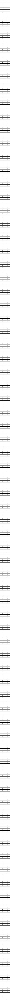

In [ ]:
export_init_pos(initial_position_words_entopy, "word", nature_name)

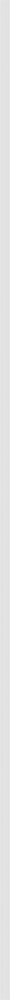

In [ ]:
export_init_pos(non_nature_initial_position_words_entopy, "word", non_nature_name)

###Counting Word-Form entropy for all the sentential positions

In [ ]:
def word_position_entropy(df, column_name):
  total_entropy_words_ = pd.DataFrame(columns=[column_name, 'Relative Entropy'])
  # Iterate through each row in the original DataFrame
  for index, row in df.iterrows():
    paragraph = row[column_name]
    entropy_table = process_paragraph(paragraph)  # Extract the total entropy value
    entropy_value = entropy_table['Entropy (-p1log2p1)'].iloc[-2]
    relative_entropy_value = entropy_table['Entropy (-p1log2p1)'].iloc[-1]  # Extract the total entropy value

    #relative_entropy_value = process_paragraph(paragraph)['Entropy (-p1log2p1)'].iloc[-1]  # Extract the total entropy value
    total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_index=True)
  return total_entropy_words_

####Create a Data Frame with all relevant information for the word-form entropy on sentential positions

In [ ]:
def word_entropy_pivot (pivot_df):
  pivot_df['Relative Entropy on Sentential Positions'] = word_position_entropy(pivot_df, "Concatenated Text")["Relative Entropy"]
  pivot_df['Entropy'] =  word_position_entropy(pivot_df, "Concatenated Text")["Entropy"]
  pivot_df['Concatenated Text'] = word_position_entropy(pivot_df, "Concatenated Text")["Concatenated Text"]
  return pivot_df


In [ ]:
pivot_df_concatenated = word_entropy_pivot(pivot_df_concatenated)
pivot_rows_100_last = word_entropy_pivot(pivot_rows_100_last)
pivot_rows_100_first = word_entropy_pivot(pivot_rows_100_first)

pivot_df_concatenated

<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_index=True)
<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_index=True)
<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_inde

Column  \
0      word_1   
1      word_2   
2      word_3   
3      word_4   
4      word_5   
..        ...   
96    word_97   
97    word_98   
98    word_99   
99   word_100   
100  word_101   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [ ]:
pivot_non_nature_concatenated = word_entropy_pivot(pivot_non_nature_concatenated)
non_nature_pivot_rows_100_last = word_entropy_pivot(non_nature_pivot_rows_100_last)
non_nature_pivot_rows_100_first = word_entropy_pivot(non_nature_pivot_rows_100_first)

pivot_non_nature_concatenated

<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_index=True)
<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_index=True)
<ipython-input-74-493b161dc36a>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_entropy_words_ = total_entropy_words_.append({column_name:paragraph , 'Entropy': entropy_value,'Relative Entropy': relative_entropy_value}, ignore_inde

Column  \
0      word_1   
1      word_2   
2      word_3   
3      word_4   
4      word_5   
..        ...   
195  word_196   
196  word_197   
197  word_198   
198  word_199   
199  word_200   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

###Plotting the word-form entropy on sentential positions

###Plotting the word-form entropy on sentential positions of a 100 most cited and least cited artices

In [ ]:
def most_least_sentpos_word_entropy_plt(df_1, df_2, title, name_1, name_2, color_1, color_2):
  y_value_df_1= df_1['Relative Entropy on Sentential Positions']
  y_value_df_2= df_2['Relative Entropy on Sentential Positions']

  x_values_first = list(range(1, len(df_1['Relative Entropy on Sentential Positions'])+1))
  x_values_last = list(range(1, len(df_2['Relative Entropy on Sentential Positions'])+1))


  # Plotting
  plt.figure(figsize=(15, 6))
  plt.plot(x_values_first, y_value_df_1, marker='o', linestyle='-', color=color_1, label=f'{name_1}')
  plt.plot(x_values_last, y_value_df_2, marker='o', linestyle='-', color=color_2, label=f'{name_2}')

  plt.title(f'{title}')
  plt.xlabel('Sentential Position')
  plt.ylabel(f'Relative Word Entropy')
  plt.ylim(0, 1)
  plt.legend()
  plt.grid(True)
  return plt.show()

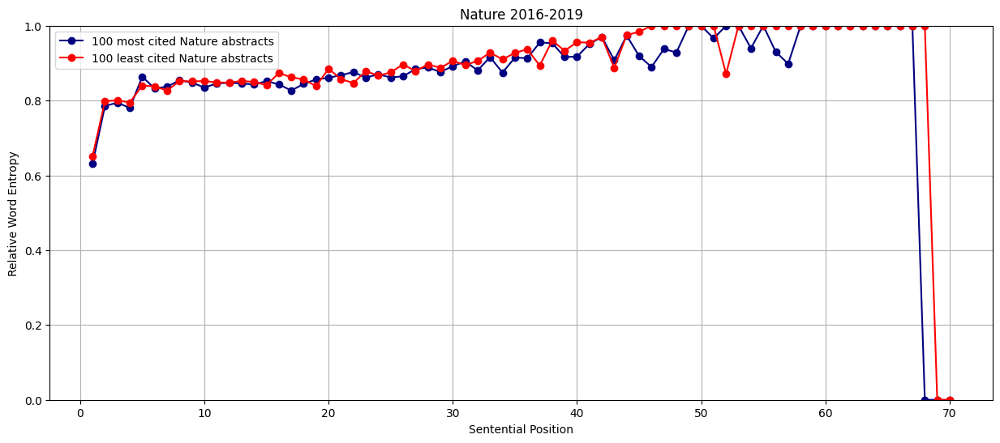

In [ ]:
most_least_sentpos_word_entropy_plt(pivot_rows_100_first[:70], pivot_rows_100_last[:70], "Nature 2016-2019", "100 most cited Nature abstracts", "100 least cited Nature abstracts", "navy", "red")

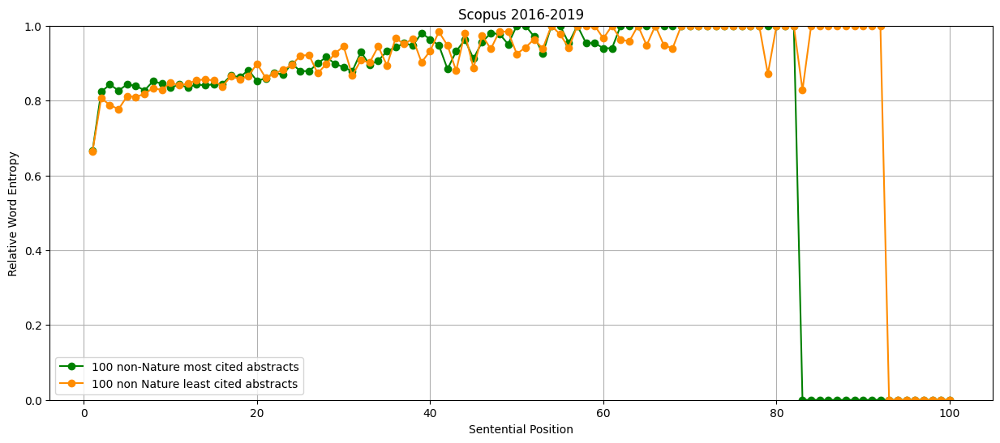

In [ ]:
most_least_sentpos_word_entropy_plt(non_nature_pivot_rows_100_first[:100], non_nature_pivot_rows_100_last[:100], "Scopus 2016-2019","100 non-Nature most cited abstracts", "100 non Nature least cited abstracts", "green", "darkorange")

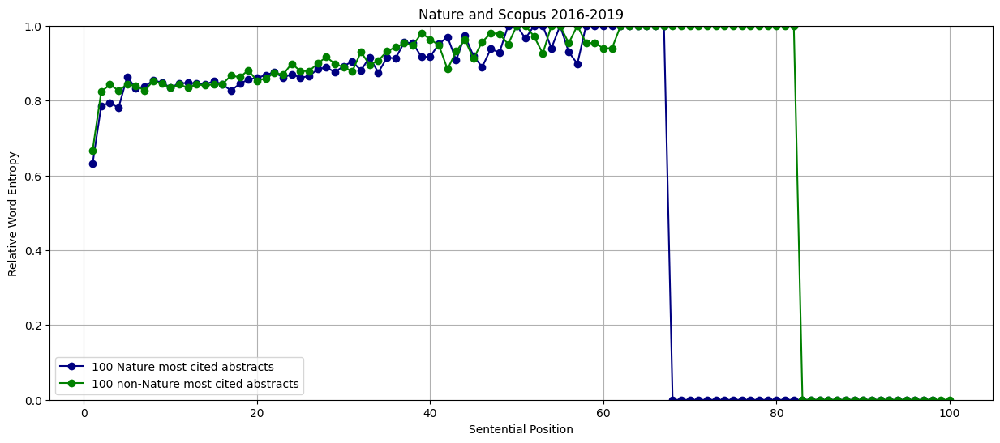

In [ ]:
most_least_sentpos_word_entropy_plt(pivot_rows_100_first[:100], non_nature_pivot_rows_100_first[:100], "Nature and Scopus 2016-2019", "100 Nature most cited abstracts", "100 non-Nature most cited abstracts", "navy", "green")

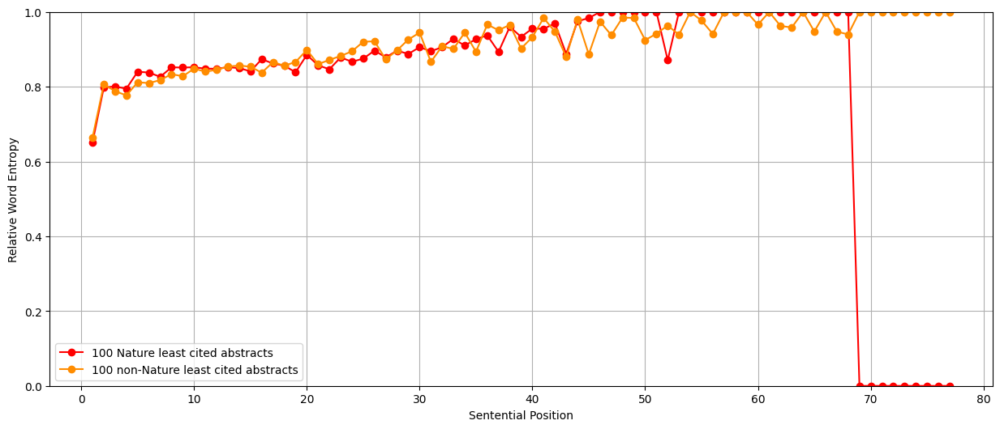

In [ ]:
most_least_sentpos_word_entropy_plt(pivot_rows_100_last, non_nature_pivot_rows_100_last[:len(pivot_rows_100_last)],"", "100 Nature least cited abstracts", "100 non-Nature least cited abstracts", "red", "darkorange")

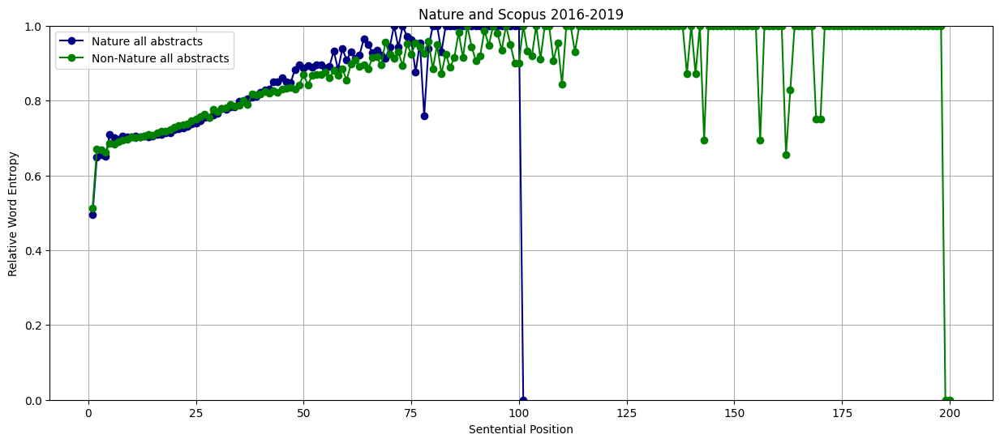

In [ ]:
most_least_sentpos_word_entropy_plt(pivot_df_concatenated, pivot_non_nature_concatenated, "Nature and Scopus 2016-2019", "Nature all abstracts", "Non-Nature all abstracts", "navy", "green")

###Plotting the relative word-form entropy of abstracts and sentential positions of all a 100 most cited articles, a 100 least cited articles and all the articles


In [ ]:
def word_entropy_plt(df, df_most, df_least, title, name1, name2, color_1, color_2, color_3):
  # Given values
  y_value_pos_100_last= df_least['Relative Entropy on Sentential Positions']
  y_value_pos_100_first= df_most["Relative Entropy on Sentential Positions"]
  all_values = df['Relative Entropy on Sentential Positions']

  x_values_last = list(range(1, len(df_least['Relative Entropy on Sentential Positions'])+1))
  x_values_first = list(range(1, len(df_most['Relative Entropy on Sentential Positions'])+1))
  x_values_all = list(range(1, len(df['Relative Entropy on Sentential Positions'])+1))

  # Plotting
  plt.figure(figsize=(15, 6))
  plt.plot(x_values_last, y_value_pos_100_last, marker='o', linestyle='-', color=color_1, label=name1)
  plt.plot(x_values_first, y_value_pos_100_first, marker='o', linestyle='-', color=color_2, label=name2)
  plt.plot(x_values_all, all_values, marker='o', linestyle='-', color=color_3, label='All values')
  plt.title(f'{title}')
  plt.xlabel('Sentential Position')
  plt.ylabel(f'Relative Word Entropy')
  plt.ylim(0, 1.1)  # Set the y-axis lower limit to 0
  plt.legend()  # Display legend
  plt.grid(True)
  return plt.show()

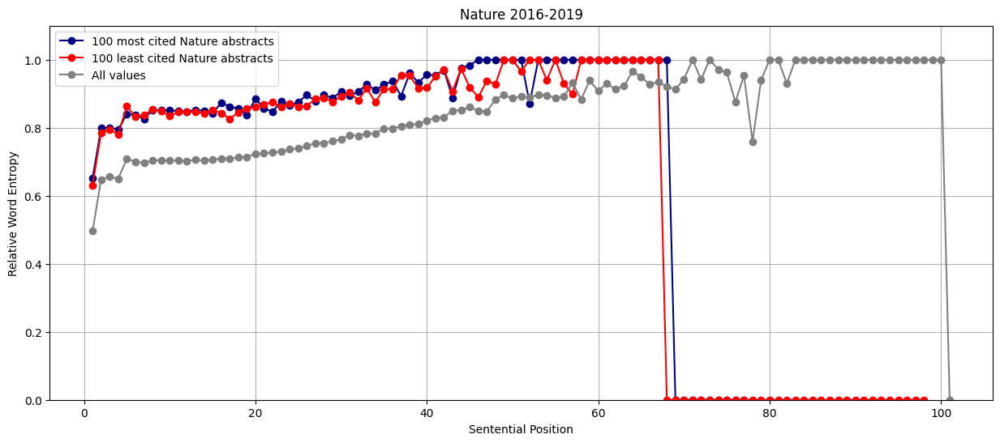

In [ ]:
word_entropy_plt(pivot_df_concatenated, pivot_rows_100_first, pivot_rows_100_last, nature_name, "100 most cited Nature abstracts", "100 least cited Nature abstracts", "navy", "red", "grey")

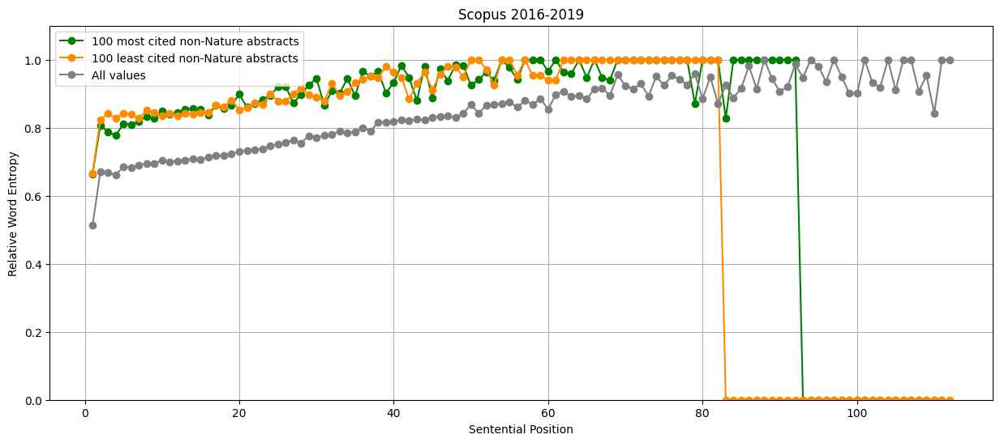

In [ ]:
word_entropy_plt(pivot_non_nature_concatenated[:len(non_nature_pivot_rows_100_first)], non_nature_pivot_rows_100_first, non_nature_pivot_rows_100_last[:len(non_nature_pivot_rows_100_first)], non_nature_name, "100 most cited non-Nature abstracts", "100 least cited non-Nature abstracts", "green", "darkorange", "gray")

##Counting the Parts of Speech entropy on the inital sentential position

In [ ]:
#ENTOPRY OF PARTS OF SPEACH IN THE FIRST SENTENCE POTISION
def init_pos_freq_table(df):
  initial_pos_freq_table = pos_frequency_analysis(df['Concatenated Text'][0])
  initial_pos_freq_table["Relative Frequency (p1)"] = initial_pos_freq_table["Relative Frequency (p1)"].apply(lambda x: round(x, 4))
  initial_pos_freq_table["Self-Information (-log2p1)"]= initial_pos_freq_table["Self-Information (-log2p1)"].apply(lambda x: round(x, 4))
  initial_pos_freq_table["Entropy (-p1log2p1)"]= initial_pos_freq_table["Entropy (-p1log2p1)"].apply(lambda x: round(x, 4))
  initial_pos_freq_table = initial_pos_freq_table.fillna('')
  return initial_pos_freq_table

In [ ]:
initial_pos_freq_table = init_pos_freq_table(pivot_df_concatenated)

In [ ]:
initial_pos_freq_table

,Part of Speech,Frequency Rank,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,DT,1,5483,0.2232,2.1634,0.4829
1,RB,2,5141,0.2093,2.2563,0.4723
2,IN,3,2852,0.1161,3.1064,0.3607
3,NN,4,2284,0.093,3.4268,0.3187
4,PRP,5,2176,0.0886,3.4967,0.3098
5,JJ,6,2055,0.0837,3.5792,0.2995
6,PRP$,7,1087,0.0443,4.498,0.1991
7,NNS,8,660,0.0269,5.2178,0.1402
8,VBG,9,615,0.025,5.3197,0.1332
9,VBP,10,610,0.0248,5.3315,0.1324


In [ ]:
non_nature_initial_pos_freq_table = init_pos_freq_table(pivot_non_nature_concatenated)

In [ ]:
non_nature_initial_pos_freq_table

,Part of Speech,Frequency Rank,Frequency,Relative Frequency (p1),Self-Information (-log2p1),Entropy (-p1log2p1)
0,DT,1,7240,0.2951,1.7608,0.5196
1,IN,2,3278,0.1336,2.904,0.3880
2,NN,3,3076,0.1254,2.9957,0.3756
3,JJ,4,2223,0.0906,3.4643,0.3139
4,NNS,5,2105,0.0858,3.5429,0.3040
5,PRP,6,1679,0.0684,3.8692,0.2648
6,RB,7,1577,0.0643,3.9596,0.2545
7,VBP,8,701,0.0286,5.1293,0.1466
8,VBG,9,461,0.0188,5.7339,0.1077
9,VBZ,10,319,0.013,6.2651,0.0815


####Creating a table with all relevant information on word-form entropy

In [ ]:
final_table_entropy_sen_position = pivot_df_concatenated.drop(columns=['Concatenated Text'])
non_nature_final_table_entropy_sen_position = pivot_non_nature_concatenated.drop(columns=['Concatenated Text'])

final_table_entropy_sen_position

Column  \
0      word_1   
1      word_2   
2      word_3   
3      word_4   
4      word_5   
..        ...   
96    word_97   
97    word_98   
98    word_99   
99   word_100   
100  word_101   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

####Exporting the pos-form entropy of the initial sentential position to pdf

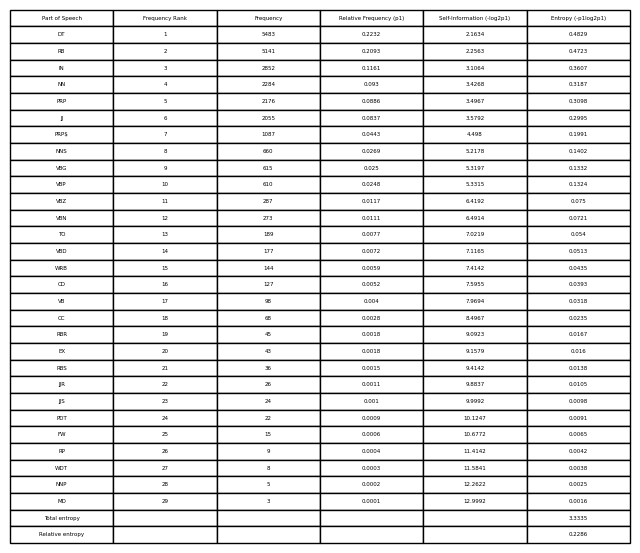

In [ ]:
# Create a table using matplotlib and pandas
fig, ax = plt.subplots(figsize=(8, 4))
ax.axis('tight')
ax.axis('off')
ax.table(cellText=initial_pos_freq_table.values, colLabels=initial_pos_freq_table.columns, cellLoc='center', loc='center')

# Save the figure to a PDF file
plt.savefig('Initial POS position entropy Nature 2016-2019.pdf', format='pdf', bbox_inches='tight')

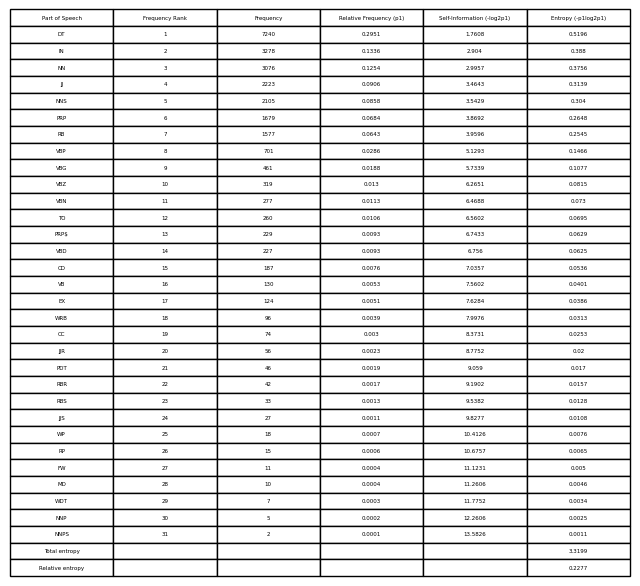

In [ ]:
# Create a table using matplotlib and pandas
fig, ax = plt.subplots(figsize=(8, 4))
ax.axis('tight')
ax.axis('off')
ax.table(cellText=non_nature_initial_pos_freq_table.values, colLabels=non_nature_initial_pos_freq_table.columns, cellLoc='center', loc='center')

# Save the figure to a PDF file
plt.savefig('Initial POS position entropy Scopus 2016-2019.pdf', format='pdf', bbox_inches='tight')

##Counting POS-form entropy for all sentential positions

In [ ]:
def pos_position_entropy(df, column_name):
  total_relative_pos_entropy = pd.DataFrame(columns=[column_name,'Position','POS Total Entropy','POS Relative Entropy'])

  # Iterate through each row in the original DataFrame
  for index, row in df.iterrows():
    paragraph = row[column_name]
    pos_entropy_table = pos_frequency_analysis(paragraph)
    pos_entropy_value = pos_entropy_table['Entropy (-p1log2p1)'].iloc[-2]
    relative_entropy_pos_value = pos_entropy_table['Entropy (-p1log2p1)'].iloc[-1]  # Extract the total entropy value
    total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)

  #total_relative_pos_entropy['Position'] = [f'pos_{i}' for i in range(1, 18)]
  return total_relative_pos_entropy

In [ ]:
# Function to count words in a text
def count_pos(text):
    words = word_tokenize(text)

    # Perform part-of-speech tagging
    pos_tags = nltk.pos_tag(words)

    # Count the frequency of each part of speech
    pos_frequency = Counter(tag for word, tag in pos_tags)
    sorted_keys = [key for key, _ in pos_frequency.most_common()]

    return  sorted_keys, len(pos_frequency.values())

####Create a table with all relevant information

In [ ]:
def final_table_pos(df_pos_pivot):
  pos_final_all_positions_entropy = pos_position_entropy(df_pos_pivot,'Concatenated Text')
  pos_final_all_positions_entropy[['Sorted Keys', 'Number of POS types']] = pos_final_all_positions_entropy['Concatenated Text'].apply(lambda x: pd.Series(count_pos(x)))
  pos_final_all_positions_entropy = pos_final_all_positions_entropy[['Position', 'Sorted Keys',	'Number of POS types', 'Number of POS types', 'POS Total Entropy', 'POS Relative Entropy']]
  return pos_final_all_positions_entropy

In [ ]:
#Create the final tables with all information from a 100 most and least cited abstracts
pos_final_100_last_positions_entropy = final_table_pos(pivot_rows_100_last)
pos_final_100_first_positions_entropy = final_table_pos(pivot_rows_100_first)

<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = 

In [ ]:
#Display the final table for the least cited abstracts
pos_final_100_last_positions_entropy

,Position,Sorted Keys,Number of POS types,Number of POS types,POS Total Entropy,POS Relative Entropy
0,pos_1,"[DT, RB, IN, NN, JJ, PRP, PRP$, NNS, VBP, VBG, VBN, VBZ, TO, VBD, CC, WRB, CD, VB, JJR, RBR, RP, FW, PDT, WDT, RBS, EX]",26,26,3.397486,0.344643
1,pos_2,"[NN, JJ, NNS, PRP, DT, VBP, IN, RB, VBG, VBZ, VBD, PRP$, CC, VB, VBN, MD, TO, JJS, EX, CD, RBS, JJR, WDT, PDT, FW, RBR]",26,26,3.658779,0.371149
2,pos_3,"[NN, JJ, IN, NNS, DT, VBP, VBZ, VBD, VB, VBG, RB, VBN, CC, TO, WDT, MD, PRP$, CD, JJS, FW, WRB, RBR, PRP, PDT, RP]",25,25,3.389782,0.343862
3,pos_4,"[NN, DT, IN, JJ, NNS, VBP, VBZ, RB, VBN, VBG, WDT, VBD, CC, VB, PRP$, PRP, CD, TO, WRB, MD, FW, JJS, RBS, JJR, PDT]",25,25,3.561846,0.361316
4,pos_5,"[NN, IN, JJ, NNS, DT, VBP, VBZ, RB, VBN, VBD, VB, TO, CC, VBG, WDT, MD, PRP, CD, JJS, RBR, WP$, WRB, PRP$]",23,23,3.515143,0.356635
...,...,...,...,...,...,...
72,pos_73,[NN],1,1,-0.000000,0.000000
73,pos_74,[PRP$],1,1,-0.000000,0.000000
74,pos_75,[JJS],1,1,-0.000000,0.000000
75,pos_76,[IN],1,1,-0.000000,0.000000


In [ ]:
non_nature_pos_final_100_last_positions_entropy = final_table_pos(non_nature_pivot_rows_100_last)
non_nature_pos_final_100_first_positions_entropy = final_table_pos(non_nature_pivot_rows_100_first)

<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = 

In [ ]:
non_nature_pos_final_100_last_positions_entropy

,Position,Sorted Keys,Number of POS types,Number of POS types,POS Total Entropy,POS Relative Entropy
0,pos_1,"[DT, NN, JJ, NNS, IN, RB, PRP, VBP, VBD, VBG, VBZ, TO, VBN, VB, CD, EX, PRP$, RBS, RP, WRB, RBR, JJS, CC, PDT, JJR]",25,25,3.183808,0.329344
1,pos_2,"[NN, JJ, NNS, DT, IN, VBD, VBP, VBZ, VBG, CC, VBN, RB, TO, VB, PRP, MD, CD, EX, JJS, RP, PRP$, RBR, FW, JJR]",24,24,3.423170,0.354170
2,pos_3,"[NN, IN, JJ, NNS, VBD, DT, VBZ, VBN, VBP, RB, CC, VBG, TO, MD, VB, CD, WDT, JJR, RBR, RP, PRP, WRB, WP, JJS]",24,24,3.469885,0.359069
3,pos_4,"[NN, DT, IN, JJ, NNS, VBD, VBN, VBZ, VBP, RB, TO, CC, VB, VBG, WDT, MD, CD, PRP$, RP, RBR, JJR, WRB, PRP, WP, JJS, FW, EX]",27,27,3.628423,0.375544
4,pos_5,"[NN, JJ, IN, DT, NNS, VBD, VBN, CC, TO, VBZ, RB, VBP, VB, VBG, JJR, MD, CD, RBR, WRB, EX, PRP, RBS, PRP$, RP, JJS]",25,25,3.499015,0.362217
...,...,...,...,...,...,...
106,pos_107,[NN],1,1,-0.000000,0.000000
107,pos_108,[CC],1,1,-0.000000,0.000000
108,pos_109,[NN],1,1,-0.000000,0.000000
109,pos_110,[NN],1,1,-0.000000,0.000000


In [ ]:
#Create the final tables with all information from all abstracts
pos_final_all_positions_entropy = final_table_pos(pivot_df_concatenated)
pos_final_all_positions_entropy

<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = 

,Position,Sorted Keys,Number of POS types,Number of POS types,POS Total Entropy,POS Relative Entropy
0,pos_1,"[DT, RB, IN, NN, PRP, JJ, PRP$, NNS, VBG, VBP, VBZ, VBN, TO, VBD, WRB, CD, VB, CC, RBR, EX, RBS, JJR, JJS, PDT, FW, RP, WDT, NNP, MD]",29,29,3.333540,0.228573
1,pos_2,"[NN, JJ, NNS, PRP, VBP, DT, IN, VBZ, VBG, RB, VBD, VBN, VB, PRP$, CC, TO, CD, MD, JJS, JJR, RBR, WDT, WRB, RBS, EX, RP, FW, PDT, NNP, '', WP]",31,31,3.567587,0.244624
2,pos_3,"[NN, JJ, IN, NNS, DT, VBP, VBZ, RB, VBN, VBD, VB, VBG, CC, TO, WDT, MD, PRP$, PRP, CD, JJS, JJR, WRB, RBR, FW, PDT, RP, RBS, NNP, EX, WP, WP$, '']",32,32,3.478803,0.238539
3,pos_4,"[NN, DT, IN, JJ, NNS, VBZ, VBP, RB, VBN, VBD, WDT, VBG, CC, VB, TO, MD, PRP, CD, WRB, PRP$, JJR, JJS, PDT, RBR, RP, FW, RBS, NNP, EX, WP, NNPS]",31,31,3.561590,0.244221
4,pos_5,"[NN, JJ, IN, DT, NNS, VBP, VBZ, VBN, RB, VBD, VBG, CC, VB, TO, WDT, MD, PRP, CD, WRB, PRP$, JJR, JJS, RBR, RBS, EX, RP, PDT, FW, NNP, WP$, POS, '', WP]",33,33,3.518040,0.241248
...,...,...,...,...,...,...
96,pos_97,"[NN, VBZ, RBR, DT]",4,4,2.000000,1.000000
97,pos_98,"[NN, NNS, CC]",3,3,1.500000,0.750000
98,pos_99,"[CC, VB]",2,2,1.000000,1.000000
99,pos_100,[NN],1,1,-0.000000,-0.000000


In [ ]:
non_nature_pos_final_all_positions_entropy = final_table_pos(pivot_non_nature_concatenated)
non_nature_pos_final_all_positions_entropy

<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = total_relative_pos_entropy.append({column_name: paragraph, 'Position':f'pos_{index+1}' , 'POS Total Entropy':pos_entropy_value, 'POS Relative Entropy': relative_entropy_pos_value}, ignore_index=True)
<ipython-input-95-77ddfaed6a24>:10: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  total_relative_pos_entropy = 

,Position,Sorted Keys,Number of POS types,Number of POS types,POS Total Entropy,POS Relative Entropy
0,pos_1,"[DT, IN, NN, JJ, NNS, PRP, RB, VBP, VBG, VBZ, VBN, TO, PRP$, VBD, CD, VB, EX, WRB, CC, JJR, PDT, RBR, RBS, JJS, WP, RP, FW, MD, WDT, NNP, NNPS]",31,31,3.319906,0.227663
1,pos_2,"[NN, JJ, DT, NNS, IN, VBZ, VBP, VBD, PRP, RB, VBN, VBG, CC, TO, VB, MD, PRP$, CD, JJS, RBS, EX, JJR, RBR, WP, WRB, WDT, RP, PDT, FW, NNP]",30,30,3.507007,0.240604
2,pos_3,"[NN, JJ, IN, NNS, DT, VBD, VBZ, VBN, VBP, RB, CC, VB, VBG, TO, MD, PRP, CD, WDT, PRP$, JJR, JJS, WRB, RBR, WP, PDT, RP, FW, EX, RBS, NNP]",30,30,3.537014,0.242735
3,pos_4,"[NN, IN, DT, JJ, NNS, VBD, VBN, VBZ, VBP, RB, TO, CC, VB, VBG, PRP, WDT, MD, CD, PRP$, JJR, WRB, JJS, RBR, RP, WP, RBS, EX, PDT, FW, NNP, WP$]",31,31,3.627831,0.249023
4,pos_5,"[NN, IN, JJ, DT, NNS, VBD, VBN, VBZ, VBP, RB, CC, TO, VBG, VB, PRP, MD, CD, WDT, JJR, PRP$, JJS, RBR, WP, WRB, RBS, RP, EX, PDT, FW, NNP, POS]",31,31,3.576284,0.245571
...,...,...,...,...,...,...
195,pos_196,"[NN, IN]",2,2,1.000000,1.000000
196,pos_197,"[PRP$, NN]",2,2,1.000000,1.000000
197,pos_198,"[JJ, NN]",2,2,1.000000,1.000000
198,pos_199,[NN],1,1,-0.000000,0.000000


####Plotting the relative POS-form entropy and sentential positions of all the abstracts

####Plotting the relative POS-form entropy and sentential positions of all a 100 most cited and least cited abstracts


In [ ]:
def compare_pos_sent_position_entropy_plt(df1, df2, df3, title, name1, name2, color1, color2):

  y_value_pos_100_first= df1['POS Relative Entropy']
  y_value_pos_100_second= df2['POS Relative Entropy']
  y_value_pos_100_third= df3['POS Relative Entropy']


  x_values_first = list(range(1, len(y_value_pos_100_first)+1))
  x_values_second = list(range(1, len(y_value_pos_100_second)+1))
  x_values_third = list(range(1, len(y_value_pos_100_third)+1))

  # Plotting
  plt.figure(figsize=(15, 6))
  plt.plot(x_values_first, y_value_pos_100_first, marker='o', linestyle='-', color=color1, label=f'{name1}')
  plt.plot(x_values_second, y_value_pos_100_second, marker='o', linestyle='-', color=color2, label=f'{name2}')
  plt.plot(x_values_third, y_value_pos_100_third,  marker='o', linestyle='-', color="gray", label='All values')


  plt.title(f'{title}')
  plt.xlabel('Sentential Position')
  plt.ylabel('Relative POS Entropy')
  plt.ylim(0, 1)  # Set the y-axis lower limit to 0
  plt.legend()  # Display legend
  plt.grid(True)
  return plt.show()

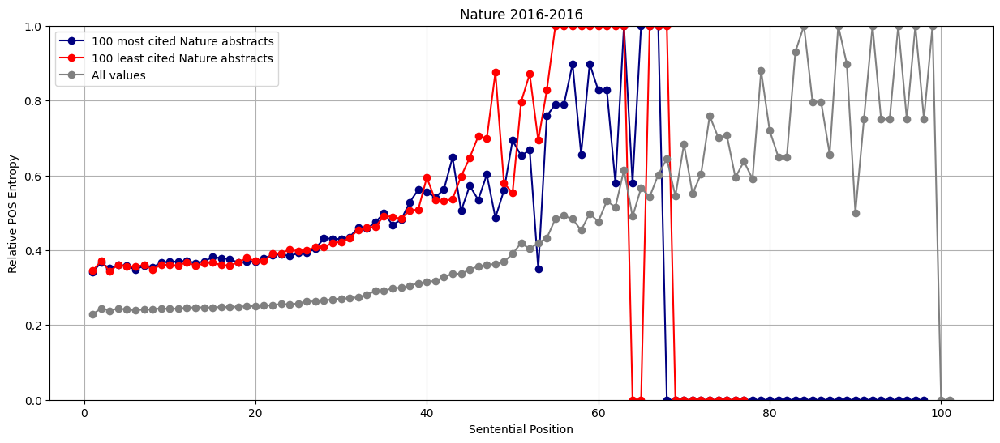

In [ ]:
compare_pos_sent_position_entropy_plt(pos_final_100_first_positions_entropy, pos_final_100_last_positions_entropy, pos_final_all_positions_entropy, "Nature 2016-2016", "100 most cited Nature abstracts", "100 least cited Nature abstracts", "navy", "red" )

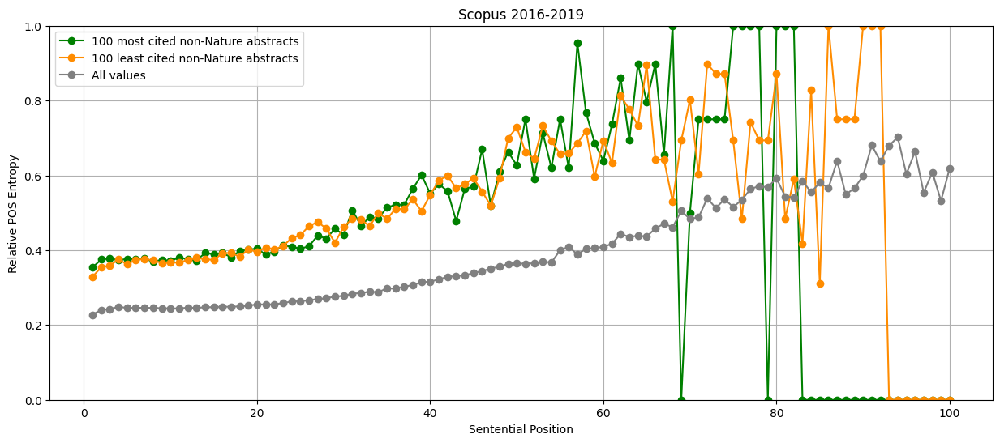

In [ ]:
compare_pos_sent_position_entropy_plt(non_nature_pos_final_100_first_positions_entropy[:100], non_nature_pos_final_100_last_positions_entropy[:100],non_nature_pos_final_all_positions_entropy[:100], non_nature_name, "100 most cited non-Nature abstracts", "100 least cited non-Nature abstracts", "green", "darkorange" )

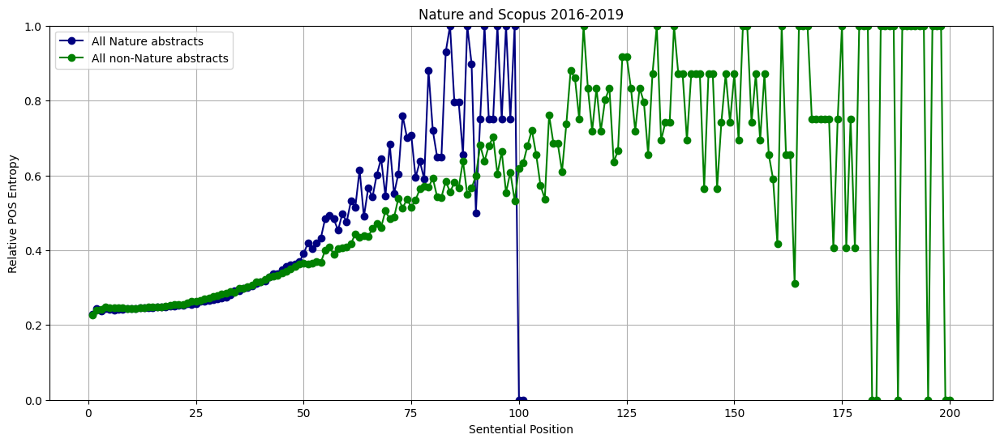

In [ ]:
y_value_pos_100_first= pos_final_all_positions_entropy['POS Relative Entropy']
y_value_pos_100_second= non_nature_pos_final_all_positions_entropy['POS Relative Entropy']

x_values_first = list(range(1, len(y_value_pos_100_first)+1))
x_values_second = list(range(1, len(y_value_pos_100_second)+1))

# Plotting
plt.figure(figsize=(15, 6))
plt.plot(x_values_first, y_value_pos_100_first, marker='o', linestyle='-', color="navy", label='All Nature abstracts')
plt.plot(x_values_second, y_value_pos_100_second, marker='o', linestyle='-', color="green", label='All non-Nature abstracts')

plt.title('Nature and Scopus 2016-2019')
plt.xlabel('Sentential Position')
plt.ylabel('Relative POS Entropy')
plt.ylim(0, 1)  # Set the y-axis lower limit to 0
plt.legend()  # Display legend
plt.grid(True)
plt.show()